In [1]:
import gymnasium as gym
from stable_baselines3 import PPO
import numpy as np

### Main

In [ ]:
# self._ctrl_cost_weigh = 0.1
# self._contact_cost_weight = 5e-7
# self._contact_cost_range = (-np.inf, 10.0)
# self._healthy_z_range = (1.0, 2.0)
# self._healthy_reward = 5.0
# self._forward_reward_weight = 1.25
# self._reset_noise_scale = 1e-2
# self._exclude_current_positions_from_observation = (True)

### Reward Scale Inspection


--- Starting Episode 1 ---
Step reward components -> survive: 5.0, forward: 0.0014645424452665776, ctrl: -0.09536690512072776, contact: -0.0
Step reward components -> survive: 5.0, forward: 0.0014553753338196126, ctrl: -0.12591262784086923, contact: -0.0
Step reward components -> survive: 5.0, forward: 0.0014260380087026403, ctrl: -0.08913346891835205, contact: -0.0
Step reward components -> survive: 5.0, forward: 0.0014743947787584461, ctrl: -0.07389915024804367, contact: -0.0
Step reward components -> survive: 5.0, forward: 0.0014385228650471392, ctrl: -0.07683480770142698, contact: -0.0
Step reward components -> survive: 5.0, forward: 0.0013691210748615601, ctrl: -0.06313322599385464, contact: -0.0
Step reward components -> survive: 5.0, forward: 0.0012903293165735775, ctrl: -0.1093819425757908, contact: -0.0
Step reward components -> survive: 5.0, forward: 0.0011783377614323655, ctrl: -0.08267443991136224, contact: -0.0
Step reward components -> survive: 5.0, forward: 0.0011815245

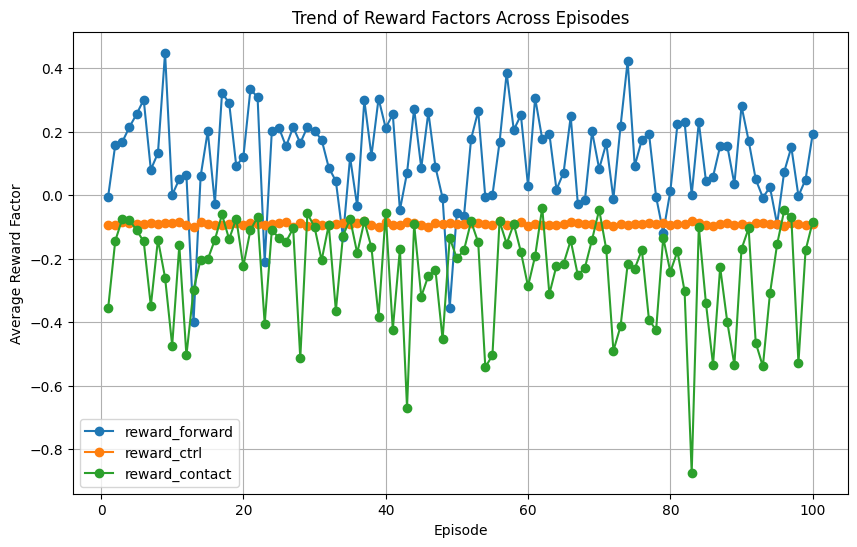

In [ ]:
import gymnasium as gym
import numpy as np
import matplotlib.pyplot as plt

# A wrapper that prints the raw reward values on each step
class Fetcher(gym.Wrapper):
    def __init__(self, env):
        super().__init__(env)

    def step(self, action):
        obs, reward, done, truncated, info = self.env.step(action)

        # Extract reward components (if available)
        survive = info.get("reward_survive", None)
        forward = info.get("reward_forward", None)
        ctrl = info.get("reward_ctrl", None)
        contact = info.get("reward_contact", None)

        # Print the individual reward components for this step
        print(
            f"Step reward components -> survive: {survive}, forward: {forward}, ctrl: {ctrl}, contact: {contact}"
        )

        return obs, reward, done, truncated, info

def inspect_rewards(num_episodes, max_steps):
    # Create the environment (adjust render_mode as needed)
    env = gym.make(
        "Humanoid-v5",
        render_mode="human",
        healthy_z_range=(0.9, 2.0)
    )
    env = Fetcher(env)

    # Overall accumulators for reward components across all episodes
    overall_survive = []
    overall_forward = []
    overall_ctrl = []
    overall_contact = []

    # Lists to record per-episode average values (for trend plotting)
    trend_survive = []
    trend_forward = []
    trend_ctrl = []
    trend_contact = []

    for episode in range(num_episodes):
        print(f"\n--- Starting Episode {episode + 1} ---")
        obs, info = env.reset()
        done = False
        truncated = False
        step_count = 0

        # Lists for accumulating reward factors within the episode
        survive_list = []
        forward_list = []
        ctrl_list = []
        contact_list = []

        while not (done or truncated) and step_count < max_steps:
            action = env.action_space.sample()  # using a random policy for inspection
            obs, reward, done, truncated, info = env.step(action)
            step_count += 1

            # Accumulate the reward factors if available
            if "reward_survive" in info and info["reward_survive"] is not None:
                survive_list.append(info["reward_survive"])
                overall_survive.append(info["reward_survive"])
            if "reward_forward" in info and info["reward_forward"] is not None:
                forward_list.append(info["reward_forward"])
                overall_forward.append(info["reward_forward"])
            if "reward_ctrl" in info and info["reward_ctrl"] is not None:
                ctrl_list.append(info["reward_ctrl"])
                overall_ctrl.append(info["reward_ctrl"])
            if "reward_contact" in info and info["reward_contact"] is not None:
                contact_list.append(info["reward_contact"])
                overall_contact.append(info["reward_contact"])

        # Compute the per-episode averages
        avg_survive = np.mean(survive_list) if survive_list else None
        avg_forward = np.mean(forward_list) if forward_list else None
        avg_ctrl = np.mean(ctrl_list) if ctrl_list else None
        avg_contact = np.mean(contact_list) if contact_list else None

        # Append per-episode averages to trend lists
        trend_survive.append(avg_survive)
        trend_forward.append(avg_forward)
        trend_ctrl.append(avg_ctrl)
        trend_contact.append(avg_contact)

        print(f"\nEpisode {episode + 1} Averages:")
        print(f"  Average reward_survive: {avg_survive}")
        print(f"  Average reward_forward: {avg_forward}")
        print(f"  Average reward_ctrl: {avg_ctrl}")
        print(f"  Average reward_contact: {avg_contact}")

    # Compute total (overall) averages across all episodes
    overall_avg_survive = np.mean(overall_survive) if overall_survive else None
    overall_avg_forward = np.mean(overall_forward) if overall_forward else None
    overall_avg_ctrl = np.mean(overall_ctrl) if overall_ctrl else None
    overall_avg_contact = np.mean(overall_contact) if overall_contact else None

    print("\n--- Total Averages across all Episodes ---")
    print(f"Total Average reward_survive: {overall_avg_survive}")
    print(f"Total Average reward_forward: {overall_avg_forward}")
    print(f"Total Average reward_ctrl: {overall_avg_ctrl}")
    print(f"Total Average reward_contact: {overall_avg_contact}")

    # Plot the trend of per-episode averages for each reward factor
    episodes = np.arange(1, num_episodes + 1)
    plt.figure(figsize=(10, 6))
    #plt.plot(episodes, trend_survive, marker='o', label="reward_survive")
    plt.plot(episodes, trend_forward, marker='o', label="reward_forward")
    plt.plot(episodes, trend_ctrl, marker='o', label="reward_ctrl")
    plt.plot(episodes, trend_contact, marker='o', label="reward_contact")
    plt.xlabel("Episode")
    plt.ylabel("Average Reward Factor")
    plt.title("Trend of Reward Factors Across Episodes")
    plt.legend()
    plt.grid(True)
    plt.show()

    env.close()

if __name__ == "__main__":
    inspect_rewards(num_episodes=100, max_steps=200)


--- Starting Episode 1 ---
Step reward components -> survive: 5.0, forward: 0.013955172244844213, ctrl: -5.0976284545353725e-05, contact: -0.0
Step reward components -> survive: 5.0, forward: 0.013955162193434713, ctrl: -5.151111795700426e-05, contact: -0.0
Step reward components -> survive: 5.0, forward: 0.013955172874533656, ctrl: -5.2026249341797324e-05, contact: -0.0
Step reward components -> survive: 5.0, forward: 0.013955171131362222, ctrl: -5.3966402615183303e-05, contact: -0.0
Step reward components -> survive: 5.0, forward: 0.01395517199759003, ctrl: -5.593924936496925e-05, contact: -0.0
Step reward components -> survive: 5.0, forward: 0.01395517166321254, ctrl: -5.802888268566171e-05, contact: -0.0
Step reward components -> survive: 5.0, forward: 0.013955172186060218, ctrl: -6.0385284334563976e-05, contact: -0.0
Step reward components -> survive: 5.0, forward: 0.013955173437986152, ctrl: -6.291277758267229e-05, contact: -0.0
Step reward components -> survive: 5.0, forward: 0

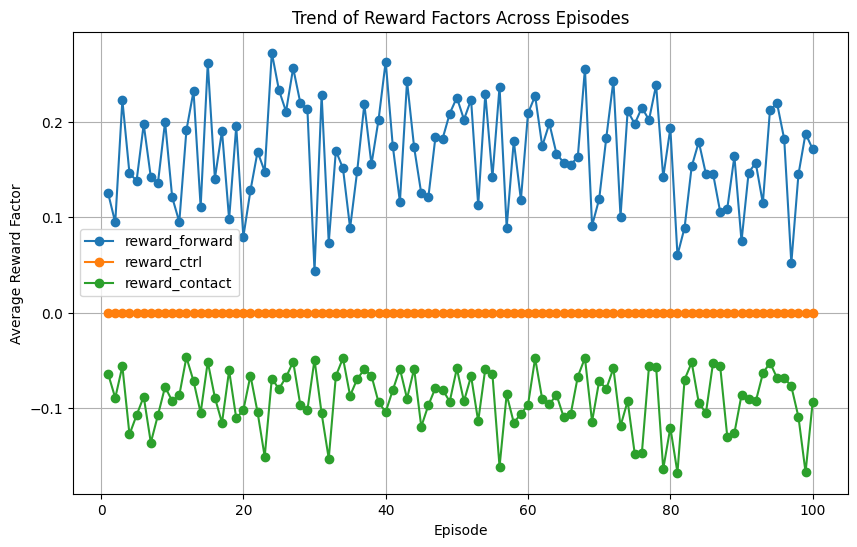

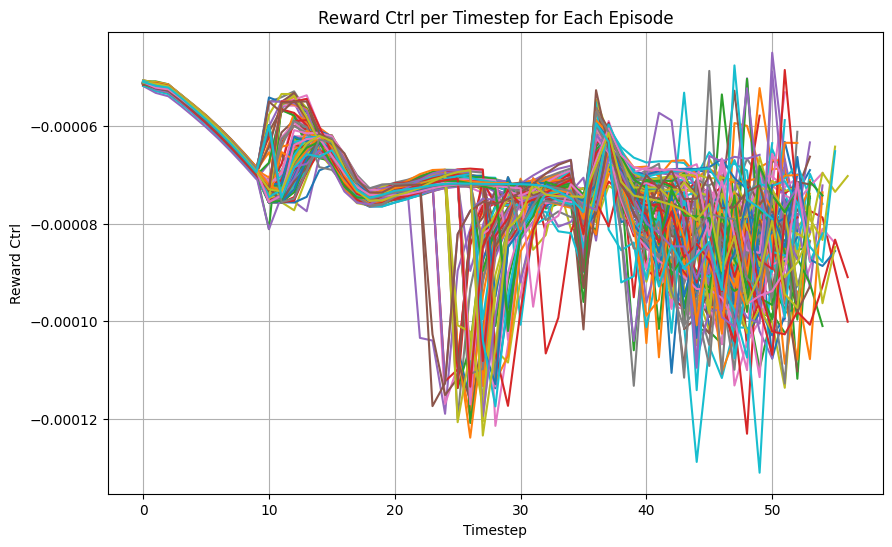

In [40]:
import gymnasium as gym
import numpy as np
import matplotlib.pyplot as plt

# A wrapper that prints the raw reward values on each step
class Fetcher(gym.Wrapper):
    def __init__(self, env):
        super().__init__(env)

    def step(self, action):
        obs, reward, done, truncated, info = self.env.step(action)

        # Extract reward components (if available)
        survive = info.get("reward_survive", None)
        forward = info.get("reward_forward", None)
        ctrl = info.get("reward_ctrl", None)
        contact = info.get("reward_contact", None)

        # Print the individual reward components for this step
        print(
            f"Step reward components -> survive: {survive}, forward: {forward}, ctrl: {ctrl}, contact: {contact}"
        )

        return obs, reward, done, truncated, info

def inspect_rewards(num_episodes, max_steps):
    # Create the environment (adjust render_mode as needed)
    env = gym.make(
        "Humanoid-v5",
        render_mode="human",
        healthy_z_range=(0.9, 2.0)
    )
    env = Fetcher(env)
    model = PPO("MlpPolicy", env)
    #model=PPO.load("spicy_sprinter", env=env)

    # Overall accumulators for reward components across all episodes
    overall_survive = []
    overall_forward = []
    overall_ctrl = []
    overall_contact = []

    # Lists to record per-episode average values (for trend plotting)
    trend_survive = []
    trend_forward = []
    trend_ctrl = []
    trend_contact = []
    
    # List to store ctrl info for every timestep of each episode
    all_ctrl_timesteps = []

    for episode in range(num_episodes):
        print(f"\n--- Starting Episode {episode + 1} ---")
        obs, info = env.reset()
        done = False
        truncated = False
        step_count = 0

        # Lists for accumulating reward factors within the episode
        survive_list = []
        forward_list = []
        ctrl_list = []
        contact_list = []

        while not (done or truncated) and step_count < max_steps:
            action, _states = model.predict(obs, deterministic=True)
            obs, reward, done, truncated, info = env.step(action)
            step_count += 1

            # Accumulate the reward factors if available
            if "reward_survive" in info and info["reward_survive"] is not None:
                survive_list.append(info["reward_survive"])
                overall_survive.append(info["reward_survive"])
            if "reward_forward" in info and info["reward_forward"] is not None:
                forward_list.append(info["reward_forward"])
                overall_forward.append(info["reward_forward"])
            if "reward_ctrl" in info and info["reward_ctrl"] is not None:
                ctrl_list.append(info["reward_ctrl"])
                overall_ctrl.append(info["reward_ctrl"])
            if "reward_contact" in info and info["reward_contact"] is not None:
                contact_list.append(info["reward_contact"])
                overall_contact.append(info["reward_contact"])

        # Save the per-timestep ctrl info for this episode
        all_ctrl_timesteps.append(ctrl_list)

        # Compute the per-episode averages
        avg_survive = np.mean(survive_list) if survive_list else None
        avg_forward = np.mean(forward_list) if forward_list else None
        avg_ctrl = np.mean(ctrl_list) if ctrl_list else None
        avg_contact = np.mean(contact_list) if contact_list else None

        # Append per-episode averages to trend lists
        trend_survive.append(avg_survive)
        trend_forward.append(avg_forward)
        trend_ctrl.append(avg_ctrl)
        trend_contact.append(avg_contact)

        print(f"\nEpisode {episode + 1} Averages:")
        print(f"  Average reward_survive: {avg_survive}")
        print(f"  Average reward_forward: {avg_forward}")
        print(f"  Average reward_ctrl: {avg_ctrl}")
        print(f"  Average reward_contact: {avg_contact}")

    # Compute total (overall) averages across all episodes
    overall_avg_survive = np.mean(overall_survive) if overall_survive else None
    overall_avg_forward = np.mean(overall_forward) if overall_forward else None
    overall_avg_ctrl = np.mean(overall_ctrl) if overall_ctrl else None
    overall_avg_contact = np.mean(overall_contact) if overall_contact else None

    print("\n--- Total Averages across all Episodes ---")
    print(f"Total Average reward_survive: {overall_avg_survive}")
    print(f"Total Average reward_forward: {overall_avg_forward}")
    print(f"Total Average reward_ctrl: {overall_avg_ctrl}")
    print(f"Total Average reward_contact: {overall_avg_contact}")

    # Plot the trend of per-episode averages for each reward factor
    episodes = np.arange(1, num_episodes + 1)
    plt.figure(figsize=(10, 6))
    plt.plot(episodes, trend_forward, marker='o', label="reward_forward")
    plt.plot(episodes, trend_ctrl, marker='o', label="reward_ctrl")
    plt.plot(episodes, trend_contact, marker='o', label="reward_contact")
    plt.xlabel("Episode")
    plt.ylabel("Average Reward Factor")
    plt.title("Trend of Reward Factors Across Episodes")
    plt.legend()
    plt.grid(True)
    plt.show()

    # Plot ctrl info per timestep for each episode (without using legend)
    plt.figure("Ctrl Info per Timestep", figsize=(10, 6))
    for ctrl_list in all_ctrl_timesteps:
        plt.plot(range(len(ctrl_list)), ctrl_list)
    plt.xlabel("Timestep")
    plt.ylabel("Reward Ctrl")
    plt.title("Reward Ctrl per Timestep for Each Episode")
    plt.grid(True)
    plt.show()

    env.close()

if __name__ == "__main__":
    inspect_rewards(num_episodes=100, max_steps=200)


--- Starting Episode 1 ---
Step reward components -> survive: 5.0, forward: -0.008188066901383207, ctrl: -0.11392565846291709, contact: -0.0
Step reward components -> survive: 5.0, forward: -0.008267274448871424, ctrl: -0.07151454275440808, contact: -0.0
Step reward components -> survive: 5.0, forward: -0.008180987172009423, ctrl: -0.11740524910478203, contact: -0.0
Step reward components -> survive: 5.0, forward: -0.00814832200824515, ctrl: -0.07649918993693408, contact: -0.0
Step reward components -> survive: 5.0, forward: -0.008255357511595613, ctrl: -0.06693615341272811, contact: -0.0
Step reward components -> survive: 5.0, forward: -0.00829940059314093, ctrl: -0.08154928880151793, contact: -0.0
Step reward components -> survive: 5.0, forward: -0.008358022845322544, ctrl: -0.09001207616936216, contact: -0.0
Step reward components -> survive: 5.0, forward: -0.008134972235501083, ctrl: -0.07145761331567446, contact: -0.0
Step reward components -> survive: 5.0, forward: -0.0082497374

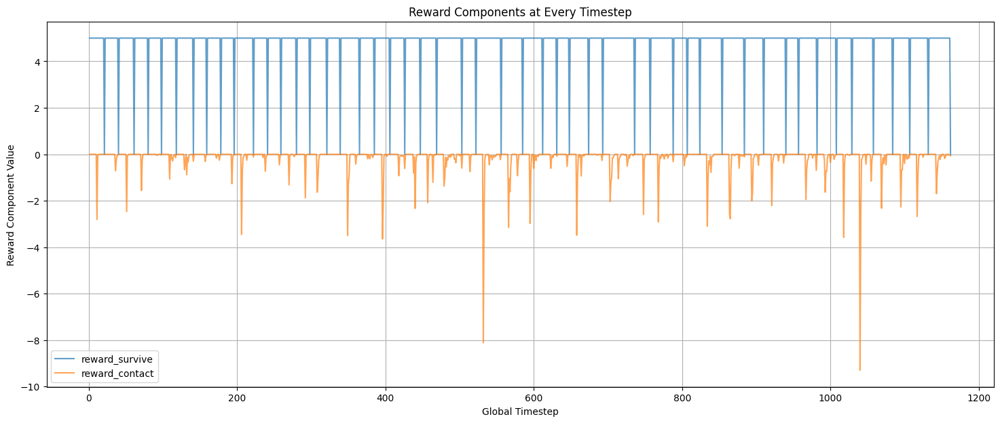

In [25]:
import gymnasium as gym
import numpy as np
import matplotlib.pyplot as plt

# A wrapper that prints the raw reward values on each step
class Fetcher(gym.Wrapper):
    def __init__(self, env):
        super().__init__(env)

    def step(self, action):
        obs, reward, done, truncated, info = self.env.step(action)

        # Extract reward components (if available)
        survive = info.get("reward_survive", None)
        forward = info.get("reward_forward", None)
        ctrl = info.get("reward_ctrl", None)
        contact = info.get("reward_contact", None)

        # Print the individual reward components for this step
        print(
            f"Step reward components -> survive: {survive}, forward: {forward}, ctrl: {ctrl}, contact: {contact}"
        )

        return obs, reward, done, truncated, info

def inspect_rewards(num_episodes, max_steps):
    # Create the environment (adjust render_mode as needed)
    env = gym.make(
        "Humanoid-v5",
        render_mode="human",
        healthy_z_range=(1.0, 2.0)
    )
    env = Fetcher(env)

    # Lists for storing every timestep's reward components
    timesteps = []
    reward_survive = []
    reward_forward = []
    reward_ctrl = []
    reward_contact = []

    global_step = 0

    for episode in range(num_episodes):
        print(f"\n--- Starting Episode {episode + 1} ---")
        obs, info = env.reset()
        done = False
        truncated = False
        step_count = 0

        while not (done or truncated) and step_count < max_steps:
            action = env.action_space.sample()  # using a random policy for inspection
            obs, reward, done, truncated, info = env.step(action)
            step_count += 1
            global_step += 1

            # Record the timestep and reward components.
            # If a reward component is missing, record np.nan so the plot will skip that value.
            timesteps.append(global_step)
            reward_survive.append(info.get("reward_survive", np.nan))
            reward_forward.append(info.get("reward_forward", np.nan))
            reward_ctrl.append(info.get("reward_ctrl", np.nan))
            reward_contact.append(info.get("reward_contact", np.nan))

    # Plot the reward components for every timestep
    plt.figure(figsize=(18, 7))
    plt.plot(timesteps, reward_survive, label="reward_survive", alpha=0.7)
    #plt.plot(timesteps, reward_forward, label="reward_forward", alpha=0.7)
    #plt.plot(timesteps, reward_ctrl, label="reward_ctrl", alpha=0.7)
    plt.plot(timesteps, reward_contact, label="reward_contact", alpha=0.7)
    plt.xlabel("Global Timestep")
    plt.ylabel("Reward Component Value")
    plt.title("Reward Components at Every Timestep")
    plt.legend()
    plt.grid(True)
    plt.show()

    env.close()

if __name__ == "__main__":
    inspect_rewards(num_episodes=50, max_steps=200)


--- Starting Episode 1 ---
Step reward components -> survive: 5.0, forward: 0.00845747366925506, ctrl: -0.06850955779573338, contact: -0.0
Step reward components -> survive: 5.0, forward: 0.008532936759735507, ctrl: -0.11497677532278215, contact: -0.0
Step reward components -> survive: 5.0, forward: 0.00846259246190378, ctrl: -0.10063739621662804, contact: -0.0
Step reward components -> survive: 5.0, forward: 0.008379915984209977, ctrl: -0.10852354614436771, contact: -0.0
Step reward components -> survive: 5.0, forward: 0.008493745962026279, ctrl: -0.07347318602975854, contact: -0.0
Step reward components -> survive: 5.0, forward: 0.008431347676535137, ctrl: -0.11251031645656624, contact: -0.0
Step reward components -> survive: 5.0, forward: 0.008465943097713964, ctrl: -0.10237459291524198, contact: -0.0
Step reward components -> survive: 5.0, forward: 0.008349076334205539, ctrl: -0.06894521559870258, contact: -0.0
Step reward components -> survive: 5.0, forward: 0.012712109095623533,

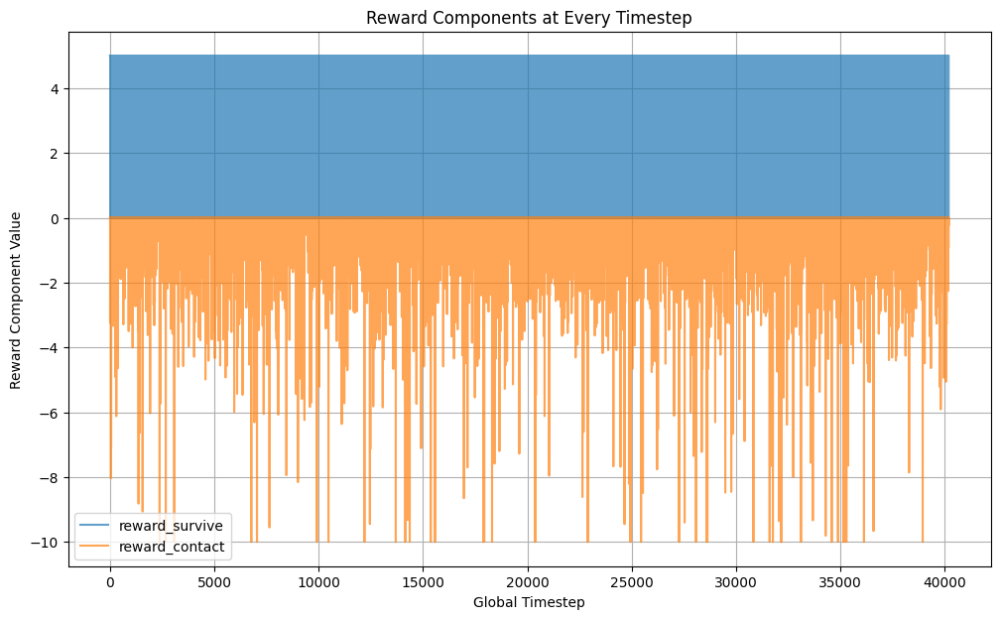

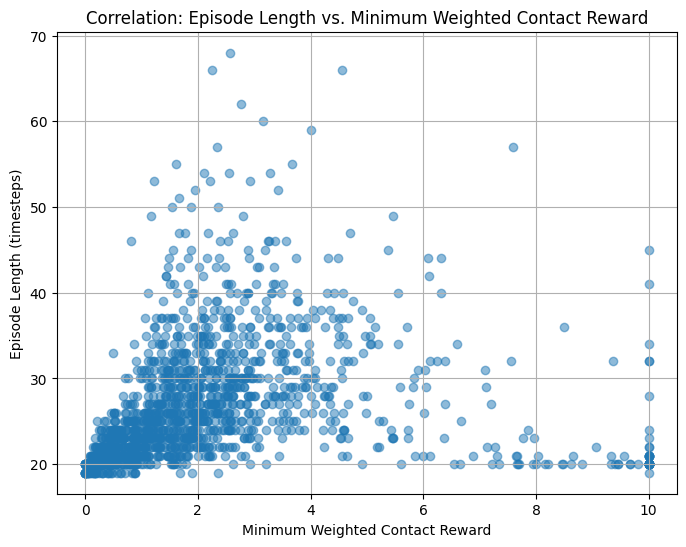

In [27]:
import gymnasium as gym
import numpy as np
import matplotlib.pyplot as plt

# A wrapper that prints the raw reward values on each step
class Fetcher(gym.Wrapper):
    def __init__(self, env):
        super().__init__(env)

    def step(self, action):
        obs, reward, done, truncated, info = self.env.step(action)

        # Extract reward components (if available)
        survive = info.get("reward_survive", None)
        forward = info.get("reward_forward", None)
        ctrl = info.get("reward_ctrl", None)
        contact = info.get("reward_contact", None)

        # Print the individual reward components for this step
        print(
            f"Step reward components -> survive: {survive}, forward: {forward}, ctrl: {ctrl}, contact: {contact}"
        )

        return obs, reward, done, truncated, info

def inspect_rewards(num_episodes, max_steps):
    # Create the environment (adjust render_mode as needed)
    env = gym.make(
        "Humanoid-v5",
        render_mode="human",
        healthy_z_range=(0.9, 2.0)
    )
    env = Fetcher(env)

    # Lists for storing reward components for every timestep across episodes
    timesteps = []
    reward_survive = []
    reward_forward = []
    reward_ctrl = []
    reward_contact = []

    # Lists to track episode-level statistics:
    #   - Episode length (in timesteps)
    #   - Minimum weighted contact reward within each episode
    episode_lengths = []
    min_contact_rewards = []

    global_step = 0

    for episode in range(num_episodes):
        print(f"\n--- Starting Episode {episode + 1} ---")
        obs, info = env.reset()
        done = False
        truncated = False
        step_count = 0

        # Lists for accumulating reward components within this episode
        survive_list = []
        forward_list = []
        ctrl_list = []
        contact_list = []

        while not (done or truncated) and step_count < max_steps:
            action = env.action_space.sample()  # using a random policy for inspection
            obs, reward, done, truncated, info = env.step(action)
            step_count += 1
            global_step += 1

            # Record each timestep's reward components.
            timesteps.append(global_step)
            reward_survive.append(info.get("reward_survive", np.nan))
            reward_forward.append(info.get("reward_forward", np.nan))
            reward_ctrl.append(info.get("reward_ctrl", np.nan))
            reward_contact.append(info.get("reward_contact", np.nan))

            # Accumulate the reward components for this episode if they exist
            if info.get("reward_survive", None) is not None:
                survive_list.append(info["reward_survive"])
            if info.get("reward_forward", None) is not None:
                forward_list.append(info["reward_forward"])
            if info.get("reward_ctrl", None) is not None:
                ctrl_list.append(info["reward_ctrl"])
            if info.get("reward_contact", None) is not None:
                contact_list.append(info["reward_contact"])

        # Record episode length
        episode_lengths.append(step_count)
        # Compute the minimum weighted contact reward for this episode, if available.
        if contact_list:
            episode_min_contact = np.min(contact_list)
        else:
            episode_min_contact = np.nan
        min_contact_rewards.append(episode_min_contact)

        print(
            f"Episode {episode + 1}: Length = {step_count} steps, "
            f"Minimum Weighted Contact Reward = {episode_min_contact}"
        )

    # Plot 1: Reward components at every timestep
    plt.figure(figsize=(12, 7))
    plt.plot(timesteps, reward_survive, label="reward_survive", alpha=0.7)
    #plt.plot(timesteps, reward_forward, label="reward_forward", alpha=0.7)
    #plt.plot(timesteps, reward_ctrl, label="reward_ctrl", alpha=0.7)
    plt.plot(timesteps, reward_contact, label="reward_contact", alpha=0.7)
    plt.xlabel("Global Timestep")
    plt.ylabel("Reward Component Value")
    plt.title("Reward Components at Every Timestep")
    plt.legend()
    plt.grid(True)
    plt.show()

    min_contact_rewards=np.array(min_contact_rewards)

    # Plot 2: Correlation between Episode Length and Minimum Weighted Contact Reward
    plt.figure(figsize=(8, 6))
    plt.scatter(abs(min_contact_rewards), episode_lengths, alpha=0.5)
    plt.ylabel("Episode Length (timesteps)")
    plt.xlabel("Minimum Weighted Contact Reward")
    plt.title("Correlation: Episode Length vs. Minimum Weighted Contact Reward")
    plt.grid(True)
    plt.show()

    env.close()

if __name__ == "__main__":
    inspect_rewards(num_episodes=1500, max_steps=200)

Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
Episode 1: Total Reward = 252.56692763782542, duration = 48
Episode 2: Total Reward = 238.42167467491214, duration = 46
Episode 3: Total Reward = 255.20874587860843, duration = 48
Episode 4: Total Reward = 246.99210994858748, duration = 47
Episode 5: Total Reward = 243.7814358544686, duration = 46
Episode 6: Total Reward = 233.52525425315528, duration = 44
Episode 7: Total Reward = 232.20579060557674, duration = 45
Episode 8: Total Reward = 232.3140876130446, duration = 44
Episode 9: Total Reward = 270.14362802602443, duration = 51
Episode 10: Total Reward = 277.8510226009194, duration = 52
Episode 11: Total Reward = 250.3900424218211, duration = 48
Episode 12: Total Reward = 241.54762693796053, duration = 45
Episode 13: Total Reward = 221.38965060218462, duration = 43
Episode 14: Total Reward = 233.94840215034853, duration = 45
Episode 15: Total Reward = 224.3446105437955, duration = 43
Episode 16: Total Rewa

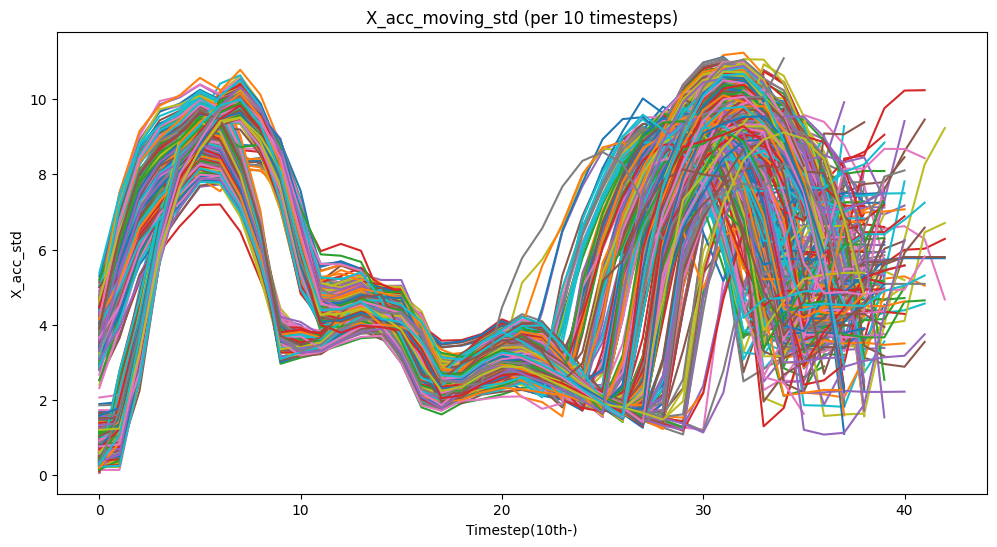

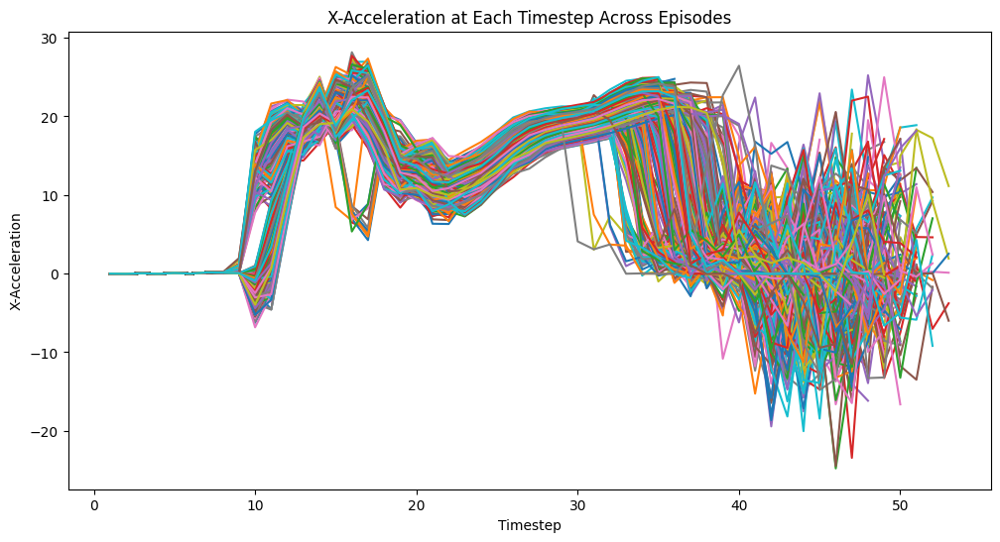

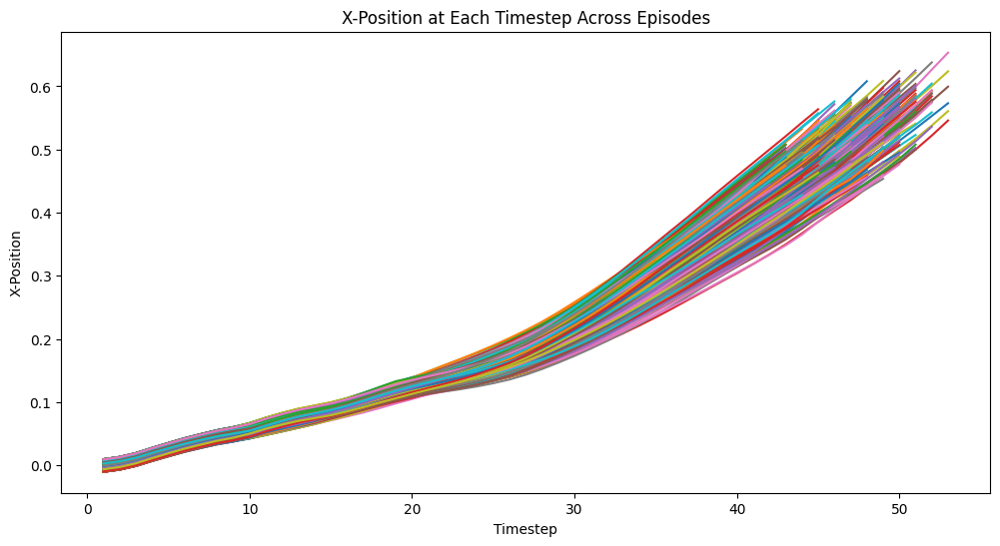

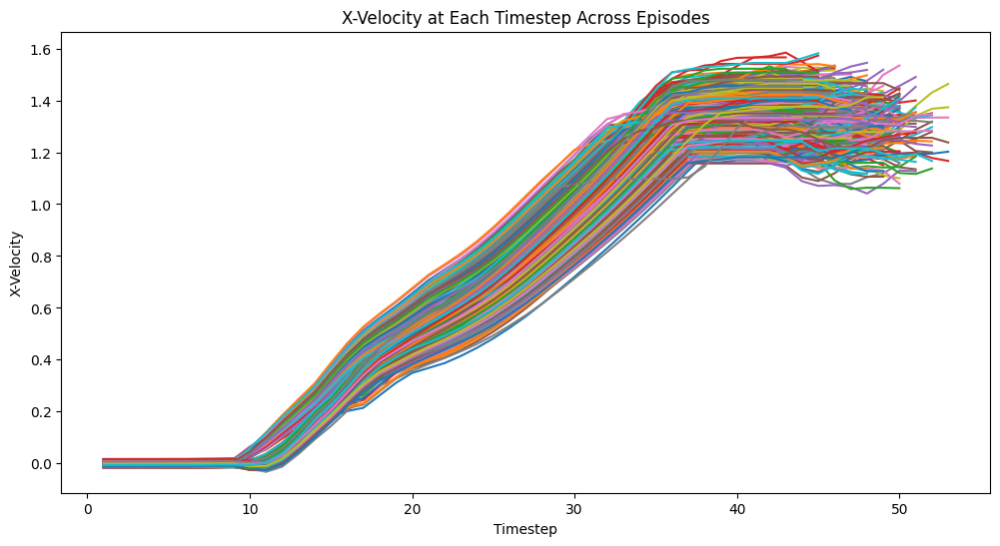

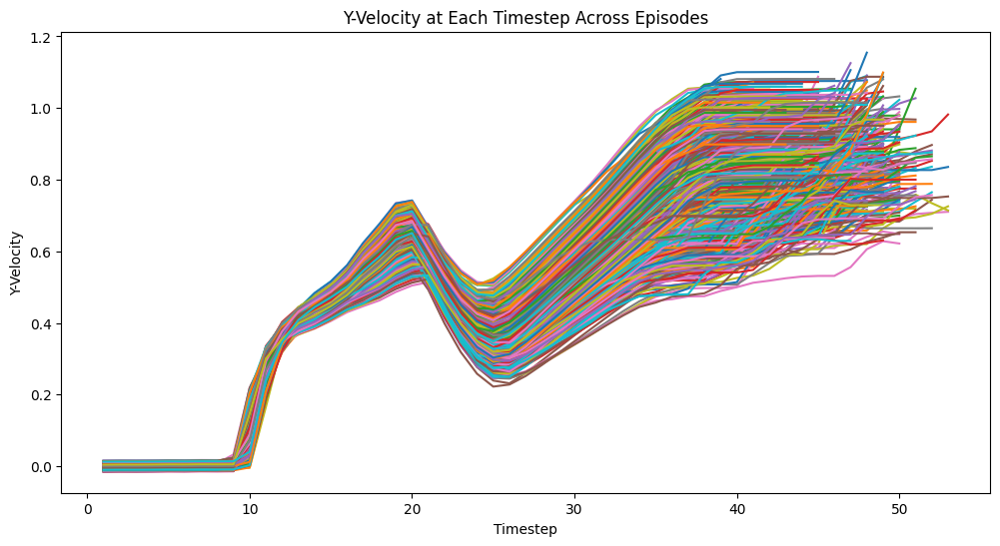

In [ ]:
from stable_baselines3 import PPO
import gymnasium as gym
import matplotlib.pyplot as plt
import numpy as np  # Used for computing trend lines
import mujoco


class CustomReward(gym.Wrapper):

    def __init__(self, env, torso_z_min):
        super().__init__(env)
        self.z_min = torso_z_min
        # Initialize last_x_velocity to 0.0 (or None if you prefer a conditional check)
        self.last_x_velocity = 0.0
        # Initialize a buffer for x_acceleration values with a moving window length of 10
        self.x_acc_buffer = []
        self.window_length = 10

    def reset(self, **kwargs):
        # When resetting the environment, also reset the last_x_velocity and the acceleration buffer
        # Note: gymnasium's reset returns (obs, info)
        obs, info = self.env.reset(**kwargs)
        self.last_x_velocity = 0.0  # or you can set this to info["x_velocity"] if available
        self.x_acc_buffer = []  # reset the moving window
        return obs, info

    def step(self, action):
        # Step the environment and get the info dictionary
        obs, reward, done, truncated, info = self.env.step(action)
        
        # X acceleration 
        dt = self.unwrapped.model.opt.timestep
        x_acceleration = (info["x_velocity"] - self.last_x_velocity) / dt
        self.last_x_velocity = info["x_velocity"]

        # Update moving window buffer for x_acceleration
        self.x_acc_buffer.append(x_acceleration)
        if len(self.x_acc_buffer) > self.window_length:
            self.x_acc_buffer.pop(0)

        # Pelvis tilt
        body_id = mujoco.mj_name2id(
            self.env.unwrapped.model,
            mujoco.mjtObj.mjOBJ_BODY.value,
            "pelvis")
        
        quat = self.env.unwrapped.data.xquat[body_id]
        pelvis_tilt = np.linalg.norm(quat[1:])

        # torso height
        qpos = self.unwrapped.data.qpos
        torso_z = qpos[2]

        survive = info["reward_survive"]
        forward = info["reward_forward"]
        ctrl = info["reward_ctrl"]
        contact = info["reward_contact"]
        x_position = info["x_position"]

        # For example, you might choose to define the reward as:
        reward = (0 * survive + 10 * forward)
        reward += 10 * x_position
        reward += 10 * (0.3 - pelvis_tilt)
    
        # Optionally, override the done flag if torso_z is above your minimum
        if torso_z >= self.z_min:
            done = False

        # At the end of the episode, incorporate the moving std of x_acceleration into the reward

        return obs, reward, done, truncated, info

# Create the environment
env = gym.make("Humanoid-v5", render_mode="human")

# Retrieve the simulation timestep (dt) from the underlying MuJoCo model.
dt = env.unwrapped.model.opt.timestep

# Load the trained model
#model = PPO("MlpPolicy", env)
model=PPO.load("spicy_walker_Xacc_stdCosine", env=env)

num_episodes = 1000  # Change this to run more episodes

# Lists to store per-episode statistics for the additional plots
episode_durations = []      # Duration (number of timesteps) per episode
episode_avg_x = []          # Average x-velocity per episode
episode_avg_y = []          # Average y-velocity per episode
episode_avg_x_acceleration = []  # Average x-acceleration per episode
sample_acc1=[]
sample_acc2=[]
sample_acc3=[]
episodes_rewards=[]
for episode in range(num_episodes):
    obs, _ = env.reset()  # Reset environment
    done = False
    total_reward = 0
    ep_length = 0
    x_velocity = []  # Store x-velocity per timestep
    y_velocity = []  # Store y-velocity per timestep
    x_position = []  # Store x-position per timestep
    timesteps = []   # Timestep indices
    x_acc_buffer=[]
    while not done:
        action, _states = model.predict(obs, deterministic=True)  # Use trained policy
        obs, reward, done, truncated, info = env.step(action)
        total_reward += reward
        ep_length += 1
        
        # Record velocities and position from the info dictionary
        x_velocity.append(info["x_velocity"])
        y_velocity.append(info["y_velocity"])
        x_position.append(info["x_position"])
        timesteps.append(ep_length)
    
        env.render()
    

    episodes_rewards.append(total_reward)
    # Compute x-acceleration using finite differences:
    # (a_x = (v_x[t] - v_x[t-1]) / dt) and set the first value to 0.

    x_acceleration = [0.0]
    for i in range(1, len(x_velocity)):
        acc = (x_velocity[i] - x_velocity[i-1]) / dt

        x_acceleration.append(acc)

        if (episode+1) == round(num_episodes/3):
            sample_acc1.append(acc)

        elif (episode+1) == round(2*(num_episodes/3)):
            sample_acc2.append(acc)

        elif (episode+1) == ((num_episodes)):
            sample_acc3.append(acc)

    # Calculate average acceleration for the episode.
    avg_x_acc = np.mean(x_acceleration)
    
    for i in range(len(x_acceleration)-10):
        x_acc_buffer.append(np.std(x_acceleration[i:i+10]))

    plt.figure("X_acc_moving_std", figsize=(12,6))
    plt.plot(range(len(x_acc_buffer)), x_acc_buffer)


    print(f"Episode {episode + 1}: Total Reward = {total_reward}, duration = {ep_length}")
    
    # Plot X-Position per episode
    plt.figure("X-Position", figsize=(12,6))
    plt.plot(timesteps, x_position, label=f"Episode {episode+1}")

    # Plot X-Velocity per episode
    plt.figure("X-Velocity", figsize=(12,6))
    plt.plot(timesteps, x_velocity, label=f"Episode {episode+1}")
    
    # Plot Y-Velocity per episode
    plt.figure("Y-Velocity", figsize=(12,6))
    plt.plot(timesteps, y_velocity, label=f"Episode {episode+1}")
    
    # Plot X-Acceleration per episode
    plt.figure("X-Acceleration", figsize=(12,6))
    plt.plot(timesteps, x_acceleration, label=f"Episode {episode+1}")
    
    # Calculate and store average velocities, acceleration, and episode duration
    avg_x = np.mean(x_velocity) if x_velocity else 0
    avg_y = np.mean(y_velocity) if y_velocity else 0
    episode_durations.append(ep_length)
    episode_avg_x.append(avg_x)
    episode_avg_y.append(avg_y)
    episode_avg_x_acceleration.append(avg_x_acc)
print(f'EPISODE LENGTH AVERAGE: {np.mean(episode_durations)}, EPISODE LENGTH STD: {np.std(episode_durations)}')
print(f'Mean Episode Reward: {np.mean(episodes_rewards)}')
env.close()

plt.figure("X_acc_moving_std")
plt.xlabel("Timestep(10th-)")
plt.ylabel("X_acc_std")
plt.title("X_acc_moving_std (per 10 timesteps)")

# Customize and display the X-Acceleration plot
plt.figure("X-Acceleration")
plt.xlabel("Timestep")
plt.ylabel("X-Acceleration")
plt.title("X-Acceleration at Each Timestep Across Episodes")


# Customize and display the X-Position plot
plt.figure("X-Position")
plt.xlabel("Timestep")
plt.ylabel("X-Position")
plt.title("X-Position at Each Timestep Across Episodes")


# Customize and display the X-Velocity plot
plt.figure("X-Velocity")
plt.xlabel("Timestep")
plt.ylabel("X-Velocity")
plt.title("X-Velocity at Each Timestep Across Episodes")


# Customize and display the Y-Velocity plot
plt.figure("Y-Velocity")
plt.xlabel("Timestep")
plt.ylabel("Y-Velocity")
plt.title("Y-Velocity at Each Timestep Across Episodes")


plt.show()

In [33]:
print(sample_acc1)
print(np.std(sample_acc1))
print(sample_acc2)
print(np.std(sample_acc2))
print(sample_acc3)
print(np.std(sample_acc3))

[-0.023272593826753358, 0.05249919262026448, -0.059743785573695044, -0.04689725477329291, -0.0007364810597797084, -0.10472385036953506, 0.057503693483323695, -0.03588257682763596, -0.0040437802863169114, 1.7943786531691448, 50.71129056728429, 58.21723630397757, 49.005411611816925, 42.06078277624923, 3.8851388698581215, -16.78942021226474, -11.69801718980031, -11.981586558286924, -15.111681616957233, -1.6644580056309384, 61.07267689033328, 32.79246309961329, 10.210533326695451, 0.08784340140784626, 0.20188705231768042, -0.2521131809152255, 0.08437743105142263, 0.015845664900574857, 0.001178487560612081, -0.007904388903893592, -9.675278419181883e-05, 0.0013747737220478247, 0.0012788901857148833, 0.025837655472556637, -0.022123882683892464, 37.8601341322344, 69.04246062827879, 87.37796547304184, 76.14216826586917, 59.96701602478545, 51.786498311447026, 44.724666936500824, 25.183649550251985, 1.873852572093604, -0.05023848846560005, -0.02634503634254178, 0.02352241864489457, -0.02480609016

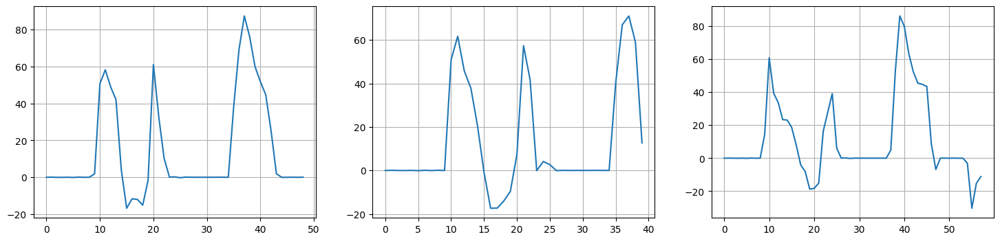

In [34]:
plt.figure(figsize=(18,4))
plt.subplot(131)
plt.plot(range(len(sample_acc1)), sample_acc1)
plt.grid(True)
plt.subplot(132)
plt.plot(range(len(sample_acc2)), sample_acc2)
plt.grid(True)
plt.subplot(133)
plt.plot(range(len(sample_acc3)), sample_acc3)
plt.grid(True)

Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
Episode 1: Total Reward = 282.8490305807464, duration = 53
Episode 2: Total Reward = 366.239531536505, duration = 64
Episode 3: Total Reward = 378.91812915091924, duration = 65
Episode 4: Total Reward = 314.65936512261413, duration = 56
Episode 5: Total Reward = 316.91277598963575, duration = 57
Episode 6: Total Reward = 223.2275955437847, duration = 44
Episode 7: Total Reward = 335.0810715267425, duration = 60
Episode 8: Total Reward = 235.55232612841132, duration = 46
Episode 9: Total Reward = 314.84439735413144, duration = 57
Episode 10: Total Reward = 330.42365397667453, duration = 60
Episode 11: Total Reward = 284.4438017353842, duration = 54
Episode 12: Total Reward = 282.86187160660734, duration = 53
Episode 13: Total Reward = 340.8345853520083, duration = 60
Episode 14: Total Reward = 375.66923587258947, duration = 66
Episode 15: Total Reward = 318.43296673036707, duration = 58
Episode 16: Total Reward

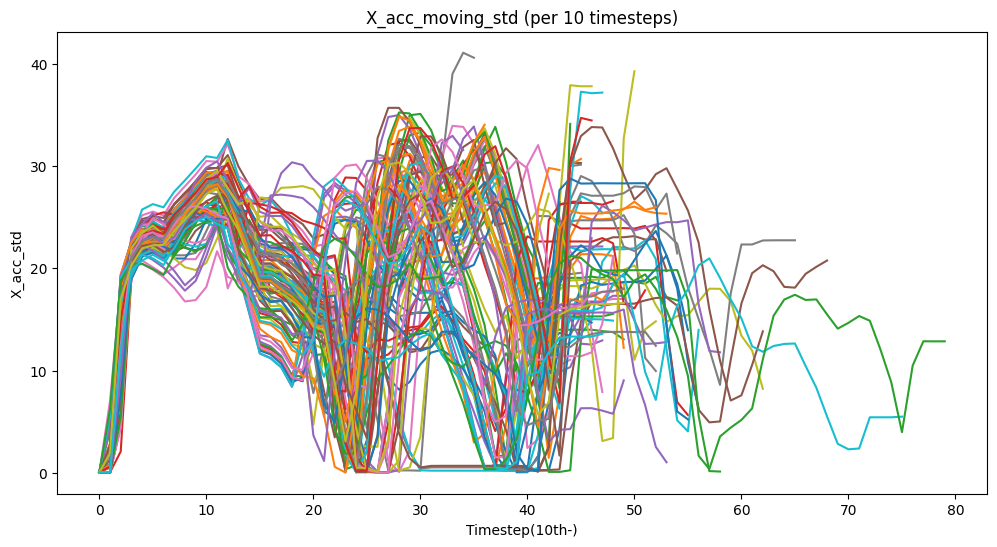

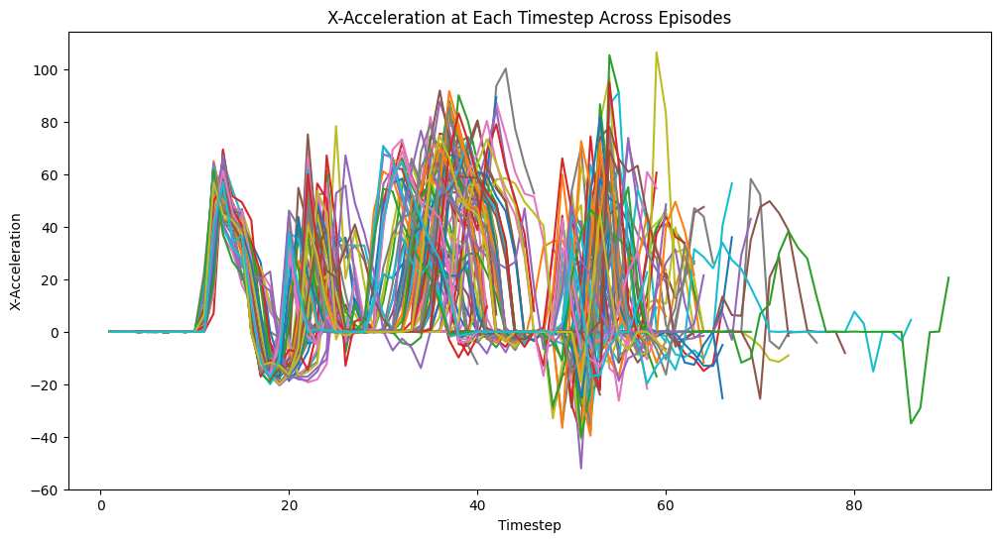

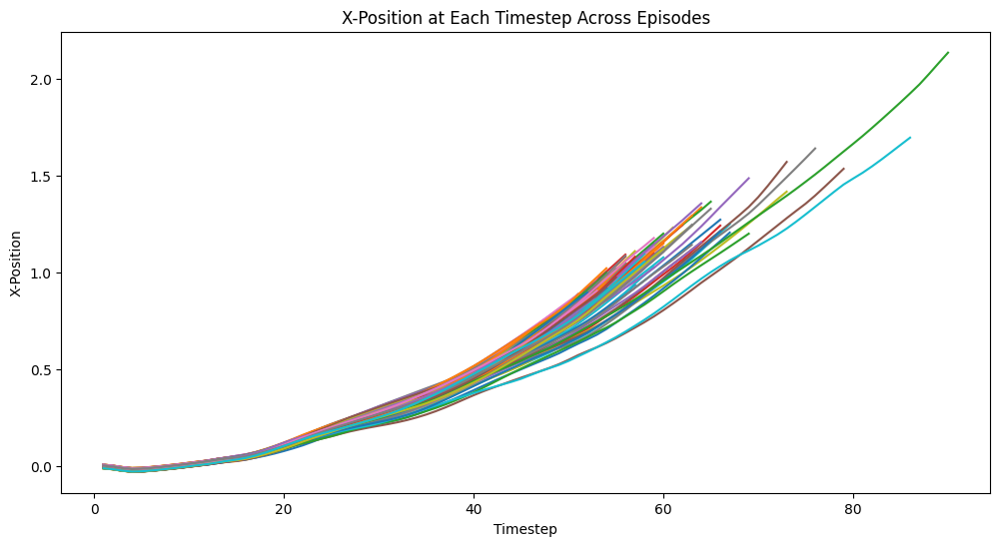

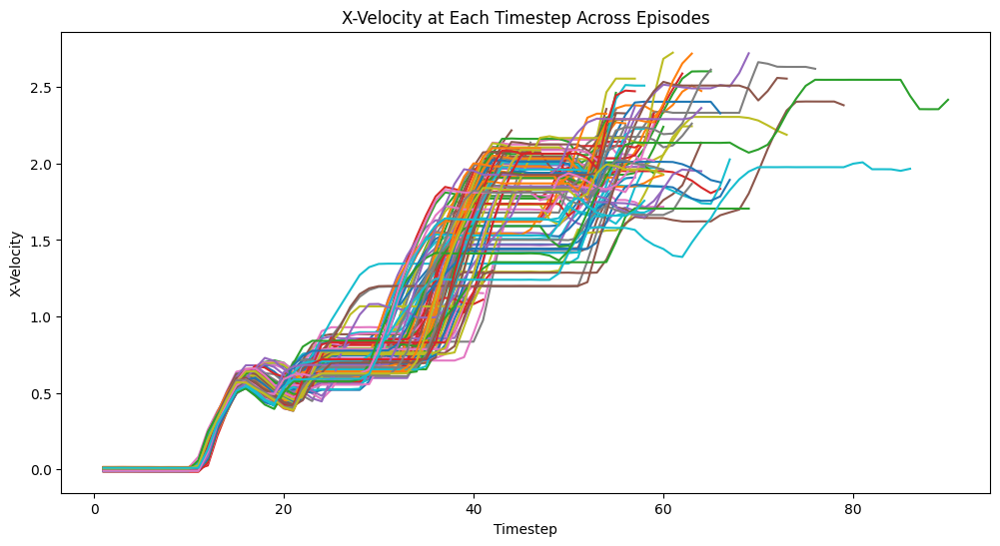

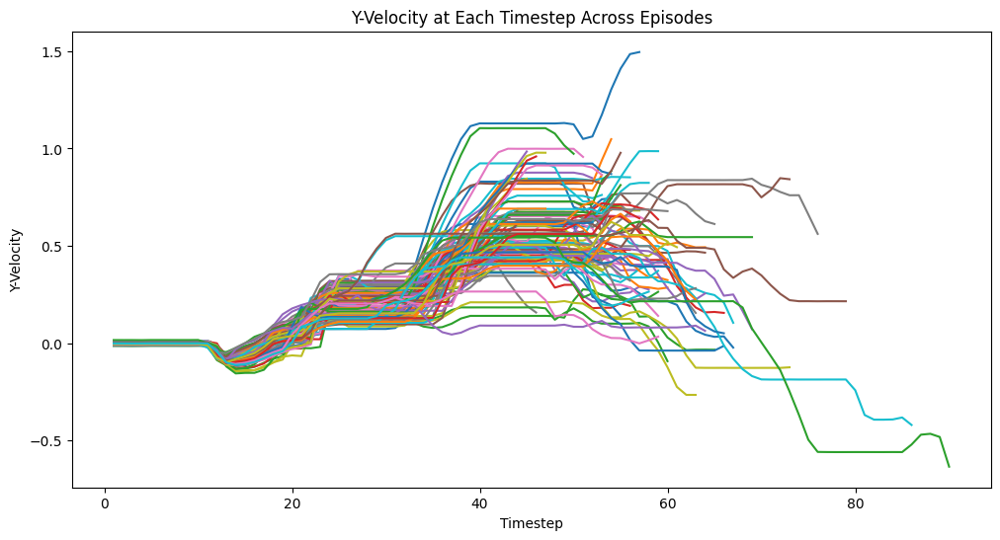

In [61]:
from stable_baselines3 import PPO
import gymnasium as gym
import matplotlib.pyplot as plt
import numpy as np  # Used for computing trend lines
import mujoco


class CustomReward(gym.Wrapper):

    def __init__(self, env, torso_z_min):
        super().__init__(env)
        self.z_min = torso_z_min
        # Initialize last_x_velocity to 0.0 (or None if you prefer a conditional check)
        self.last_x_velocity = 0.0
        # Initialize a buffer for x_acceleration values with a moving window length of 10
        self.x_acc_buffer = []
        self.window_length = 10

    def reset(self, **kwargs):
        # When resetting the environment, also reset the last_x_velocity and the acceleration buffer
        # Note: gymnasium's reset returns (obs, info)
        obs, info = self.env.reset(**kwargs)
        self.last_x_velocity = 0.0  # or you can set this to info["x_velocity"] if available
        self.x_acc_buffer = []  # reset the moving window
        return obs, info

    def step(self, action):
        # Step the environment and get the info dictionary
        obs, reward, done, truncated, info = self.env.step(action)
        
        # X acceleration 
        dt = self.unwrapped.model.opt.timestep
        x_acceleration = (info["x_velocity"] - self.last_x_velocity) / dt
        self.last_x_velocity = info["x_velocity"]

        # Update moving window buffer for x_acceleration
        self.x_acc_buffer.append(x_acceleration)
        if len(self.x_acc_buffer) > self.window_length:
            self.x_acc_buffer.pop(0)

        # Pelvis tilt
        body_id = mujoco.mj_name2id(
            self.env.unwrapped.model,
            mujoco.mjtObj.mjOBJ_BODY.value,
            "pelvis")
        
        quat = self.env.unwrapped.data.xquat[body_id]
        pelvis_tilt = np.linalg.norm(quat[1:])

        # torso height
        qpos = self.unwrapped.data.qpos
        torso_z = qpos[2]

        survive = info["reward_survive"]
        forward = info["reward_forward"]
        ctrl = info["reward_ctrl"]
        contact = info["reward_contact"]
        x_position = info["x_position"]

        # For example, you might choose to define the reward as:
        reward = (0 * survive + 10 * forward)
        reward += 10 * x_position
        reward += 10 * (0.3 - pelvis_tilt)
    
        # Optionally, override the done flag if torso_z is above your minimum
        if torso_z >= self.z_min:
            done = False

        # At the end of the episode, incorporate the moving std of x_acceleration into the reward

        return obs, reward, done, truncated, info

# Create the environment
env = gym.make("Humanoid-v5", render_mode="human")

# Retrieve the simulation timestep (dt) from the underlying MuJoCo model.
dt = env.unwrapped.model.opt.timestep

# Load the trained model
#model = PPO("MlpPolicy", env)
model=PPO.load("spicy_walker", env=env)

num_episodes = 100  # Change this to run more episodes

# Lists to store per-episode statistics for the additional plots
episode_durations = []      # Duration (number of timesteps) per episode
episode_avg_x = []          # Average x-velocity per episode
episode_avg_y = []          # Average y-velocity per episode
episode_avg_x_acceleration = []  # Average x-acceleration per episode
sample_acc1=[]
sample_acc2=[]
sample_acc3=[]
episodes_rewards=[]
for episode in range(num_episodes):
    obs, _ = env.reset()  # Reset environment
    done = False
    total_reward = 0
    ep_length = 0
    x_velocity = []  # Store x-velocity per timestep
    y_velocity = []  # Store y-velocity per timestep
    x_position = []  # Store x-position per timestep
    timesteps = []   # Timestep indices
    x_acc_buffer=[]
    while not done:
        action, _states = model.predict(obs, deterministic=True)  # Use trained policy
        obs, reward, done, truncated, info = env.step(action)
        total_reward += reward
        ep_length += 1
        
        # Record velocities and position from the info dictionary
        x_velocity.append(info["x_velocity"])
        y_velocity.append(info["y_velocity"])
        x_position.append(info["x_position"])
        timesteps.append(ep_length)
    
        env.render()
    

    episodes_rewards.append(total_reward)
    # Compute x-acceleration using finite differences:
    # (a_x = (v_x[t] - v_x[t-1]) / dt) and set the first value to 0.

    x_acceleration = [0.0]
    for i in range(1, len(x_velocity)):
        acc = (x_velocity[i] - x_velocity[i-1]) / dt

        x_acceleration.append(acc)

        if (episode+1) == round(num_episodes/3):
            sample_acc1.append(acc)

        elif (episode+1) == round(2*(num_episodes/3)):
            sample_acc2.append(acc)

        elif (episode+1) == ((num_episodes)):
            sample_acc3.append(acc)

    # Calculate average acceleration for the episode.
    avg_x_acc = np.mean(x_acceleration)
    
    for i in range(len(x_acceleration)-10):
        x_acc_buffer.append(np.std(x_acceleration[i:i+10]))

    plt.figure("X_acc_moving_std", figsize=(12,6))
    plt.plot(range(len(x_acc_buffer)), x_acc_buffer)


    print(f"Episode {episode + 1}: Total Reward = {total_reward}, duration = {ep_length}")
    
    # Plot X-Position per episode
    plt.figure("X-Position", figsize=(12,6))
    plt.plot(timesteps, x_position, label=f"Episode {episode+1}")

    # Plot X-Velocity per episode
    plt.figure("X-Velocity", figsize=(12,6))
    plt.plot(timesteps, x_velocity, label=f"Episode {episode+1}")
    
    # Plot Y-Velocity per episode
    plt.figure("Y-Velocity", figsize=(12,6))
    plt.plot(timesteps, y_velocity, label=f"Episode {episode+1}")
    
    # Plot X-Acceleration per episode
    plt.figure("X-Acceleration", figsize=(12,6))
    plt.plot(timesteps, x_acceleration, label=f"Episode {episode+1}")
    
    # Calculate and store average velocities, acceleration, and episode duration
    avg_x = np.mean(x_velocity) if x_velocity else 0
    avg_y = np.mean(y_velocity) if y_velocity else 0
    episode_durations.append(ep_length)
    episode_avg_x.append(avg_x)
    episode_avg_y.append(avg_y)
    episode_avg_x_acceleration.append(avg_x_acc)
print(f'EPISODE LENGTH AVERAGE: {np.mean(episode_durations)}, EPISODE LENGTH STD: {np.std(episode_durations)}')
print(f'Mean Episode Reward: {np.mean(episodes_rewards)}')
env.close()

plt.figure("X_acc_moving_std")
plt.xlabel("Timestep(10th-)")
plt.ylabel("X_acc_std")
plt.title("X_acc_moving_std (per 10 timesteps)")

# Customize and display the X-Acceleration plot
plt.figure("X-Acceleration")
plt.xlabel("Timestep")
plt.ylabel("X-Acceleration")
plt.title("X-Acceleration at Each Timestep Across Episodes")


# Customize and display the X-Position plot
plt.figure("X-Position")
plt.xlabel("Timestep")
plt.ylabel("X-Position")
plt.title("X-Position at Each Timestep Across Episodes")


# Customize and display the X-Velocity plot
plt.figure("X-Velocity")
plt.xlabel("Timestep")
plt.ylabel("X-Velocity")
plt.title("X-Velocity at Each Timestep Across Episodes")


# Customize and display the Y-Velocity plot
plt.figure("Y-Velocity")
plt.xlabel("Timestep")
plt.ylabel("Y-Velocity")
plt.title("Y-Velocity at Each Timestep Across Episodes")


plt.show()

In [ ]:
contact = env.unwrapped.data.cfrc_ext
contact.shape

(14, 6)

: 

Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
Episode 1: Total Reward = 329.610422870178, duration = 69
Episode 2: Total Reward = 292.2637513954545, duration = 62
Episode 3: Total Reward = 415.9447454882389, duration = 83
Episode 4: Total Reward = 382.4039093342912, duration = 73
Episode 5: Total Reward = 548.3119061887575, duration = 116
Episode 6: Total Reward = 269.9089688732054, duration = 59
Episode 7: Total Reward = 285.71463153145976, duration = 64
Episode 8: Total Reward = 275.1474878785534, duration = 64
Episode 9: Total Reward = 143.049242011273, duration = 31
Episode 10: Total Reward = 307.4858088474991, duration = 64
Episode 11: Total Reward = 517.6320795304074, duration = 106
Episode 12: Total Reward = 238.5368318106935, duration = 59
Episode 13: Total Reward = 473.2891412232899, duration = 93
Episode 14: Total Reward = 246.31592382850923, duration = 48
Episode 15: Total Reward = 293.43602061959876, duration = 55
Episode 16: Total Reward = 21

/opt/anaconda3/lib/python3.12/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/opt/anaconda3/lib/python3.12/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/opt/anaconda3/lib/python3.12/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/opt/anaconda3/lib/python3.12/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/opt/anaconda3/lib/python3.12/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


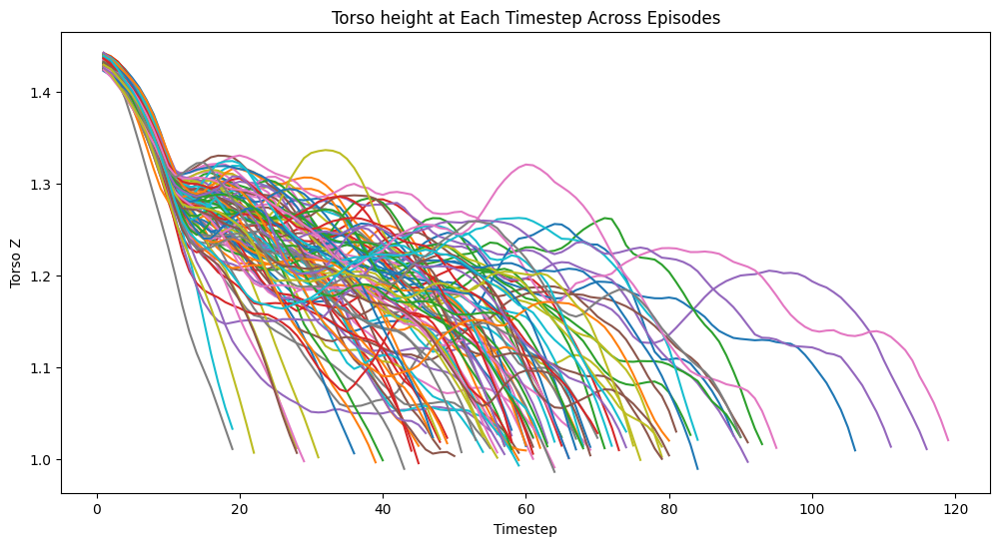

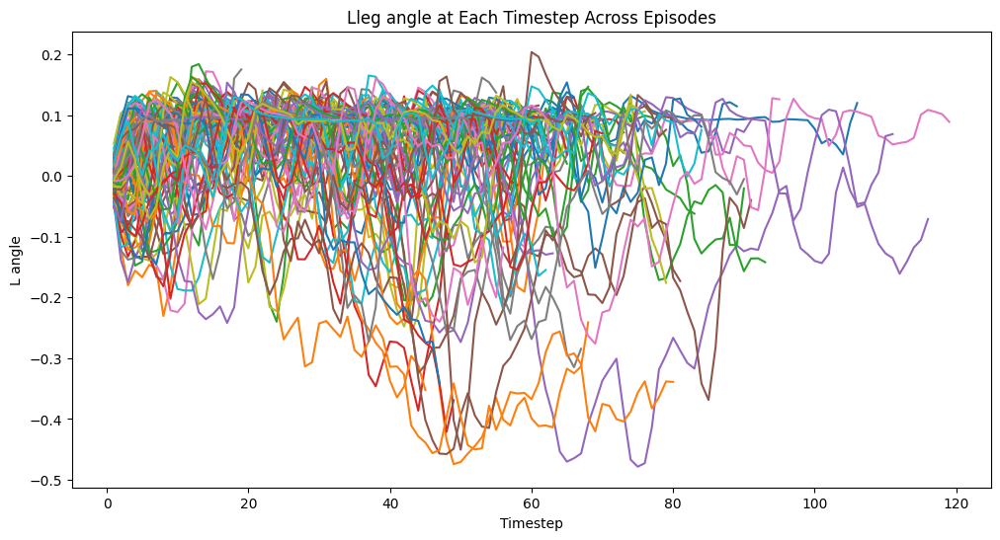

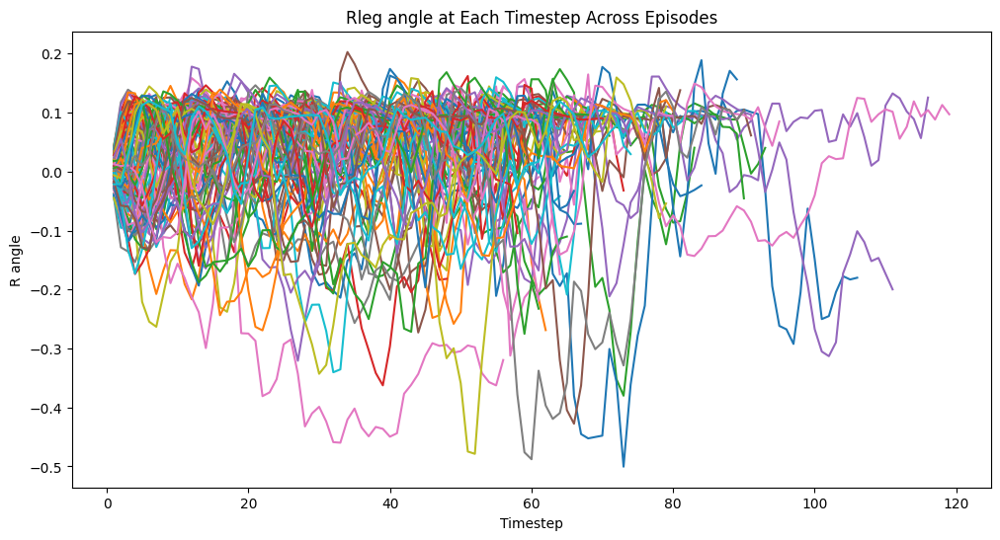

In [3]:
from stable_baselines3 import PPO
import gymnasium as gym
import matplotlib.pyplot as plt
import numpy as np  # Used for computing trend lines
import mujoco


env = gym.make("Humanoid-v5", render_mode="human")


head_id = mujoco.mj_name2id(
            env.unwrapped.model,
            mujoco.mjtObj.mjOBJ_BODY.value,
            "head")

torso_id = mujoco.mj_name2id(
            env.unwrapped.model,
            mujoco.mjtObj.mjOBJ_BODY.value,
            "torso")


#model = PPO("MlpPolicy", env)
model=PPO.load("Trinity_dancer_no_damp2", env=env, healthy_z_range=(1, 2))

num_episodes = 100  # Change this to run more episodes

# Lists to store per-episode statistics for the additional plots
episode_durations = []      # Duration (number of timesteps) per episode
episode_avg_head_z = []
episode_avg_torso_z = []

episodes_rewards=[]
for episode in range(num_episodes):
    obs, _ = env.reset()  # Reset environment
    done = False
    total_reward = 0
    ep_length = 0
    head_z = []
    torso_z = []
    R_angle = []
    L_angle =[]
    timesteps = []   # Timestep indices
    x_acc_buffer=[]

    while not done:
        action, _states = model.predict(obs, deterministic=False)  # Use trained policy
        obs, reward, done, truncated, info = env.step(action)
        total_reward += reward
        ep_length += 1
        
        # Record velocities and position from the info dictionary
        head_pos=env.unwrapped.data.xipos[head_id]
        head_z.append(head_pos[2])

        torso_pos=env.unwrapped.data.xipos[torso_id]
        torso_z.append(torso_pos[2])


        R_angle.append(obs[8])
        L_angle.append(obs[12])

        timesteps.append(ep_length)
    
        env.render()
    

    episodes_rewards.append(total_reward)


    print(f"Episode {episode + 1}: Total Reward = {total_reward}, duration = {ep_length}")
    

    plt.figure("torso height", figsize=(12,6))
    plt.plot(timesteps, torso_z, label=f"Episode {episode+1}")
   
    plt.figure("R angle", figsize=(12,6))
    plt.plot(timesteps, R_angle, label=f"Episode {episode+1}")
    
    plt.figure("L angle", figsize=(12,6))
    plt.plot(timesteps, L_angle, label=f"Episode {episode+1}")

    avg_tz = np.mean(torso_z) if torso_z else 0
    episode_avg_torso_z.append(avg_tz)
    
print(f'EPISODE LENGTH AVERAGE: {np.mean(episode_durations)}, EPISODE LENGTH STD: {np.std(episode_durations)}')
print(f'Mean Episode Reward: {np.mean(episodes_rewards)}')
env.close()

plt.figure("torso height")
plt.xlabel("Timestep")
plt.ylabel("Torso Z")
plt.title("Torso height at Each Timestep Across Episodes")

plt.figure("L angle")
plt.xlabel("Timestep")
plt.ylabel("L angle")
plt.title("Lleg angle at Each Timestep Across Episodes")


plt.figure("R angle")
plt.xlabel("Timestep")
plt.ylabel("R angle")
plt.title("Rleg angle at Each Timestep Across Episodes")


plt.show()

In [16]:
model = env.unwrapped.model
for i in range(model.nbody):
    name = mujoco.mj_id2name(model, mujoco.mjtObj.mjOBJ_BODY, i)
    print(i, name)

0 world
1 torso
2 lwaist
3 pelvis
4 right_thigh
5 right_shin
6 right_foot
7 left_thigh
8 left_shin
9 left_foot
10 right_upper_arm
11 right_lower_arm
12 left_upper_arm
13 left_lower_arm


In [63]:
ctrl=env.unwrapped.data.ctrl
print(np.mean(np.abs(ctrl)))
print(np.std(np.abs(ctrl)))

0.3834829593406004
0.048173058903001297


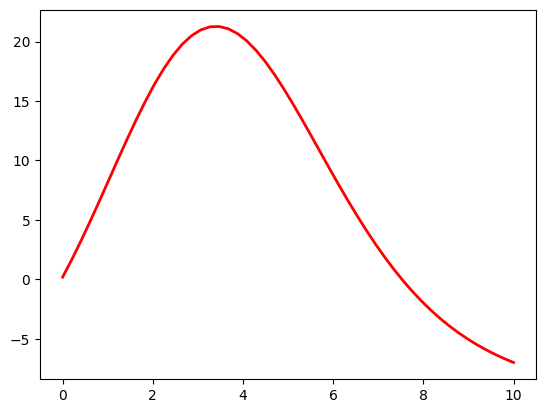

0.19590177009036047


In [8]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import exponnorm

x = np.linspace(0, 10)
pdf = exponnorm.pdf(x, K=1, loc=2, scale=2)*200-10

plt.plot(x, pdf, 'r-', lw=2, label="ExpNorm PDF")
plt.show()

print(200*exponnorm.pdf(0, K=1, loc=2, scale=2)-10)

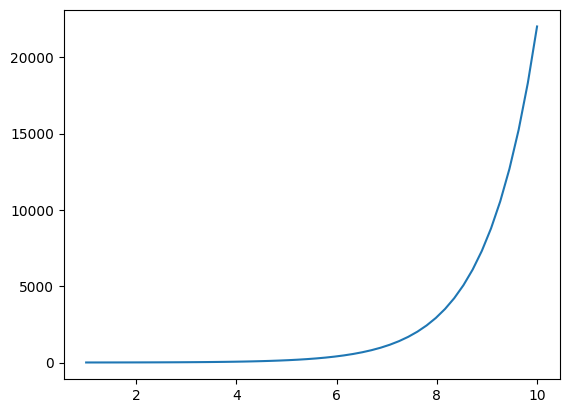

In [115]:


x = np.linspace(1,10)
plt.plot(x, np.exp(x))

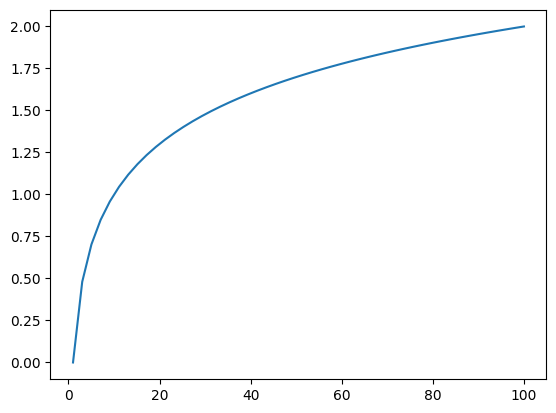

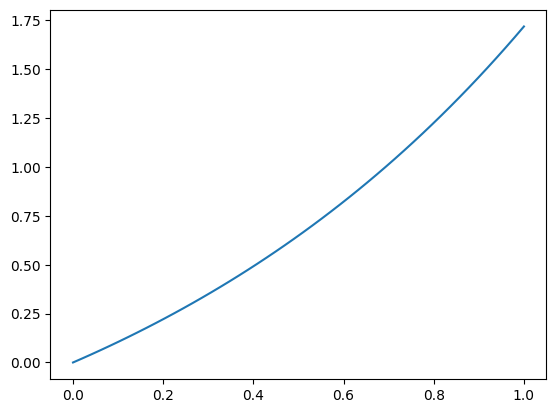

: 

In [ ]:
plt.figure()
x=np.linspace(1, 100)
plt.plot(x, np.log10(x))

plt.figure()
y=np.linspace(0, 1)
plt.plot(y, np.exp(y)-1)

Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
Episode 1: Total Reward = -28.527020957108412, duration = 79
Episode 2: Total Reward = 10.37141468560683, duration = 54
Episode 3: Total Reward = 592.3295281719808, duration = 62
Episode 4: Total Reward = 615.6557201317164, duration = 75
Episode 5: Total Reward = 46.54212071765181, duration = 49
Episode 6: Total Reward = -535.8913948707091, duration = 82
Episode 7: Total Reward = 147.38195095124362, duration = 35
Episode 8: Total Reward = -43.291055356752445, duration = 61
Episode 9: Total Reward = -158.02430327512883, duration = 37
Episode 10: Total Reward = -60.32624368216806, duration = 49
Episode 11: Total Reward = -54.58213061593233, duration = 64
Episode 12: Total Reward = 782.684155192179, duration = 111
Episode 13: Total Reward = -244.57244927687896, duration = 52
Episode 14: Total Reward = 139.71535929235853, duration = 84
Episode 15: Total Reward = 637.2358249536932, duration = 71
Episode 16: Total R

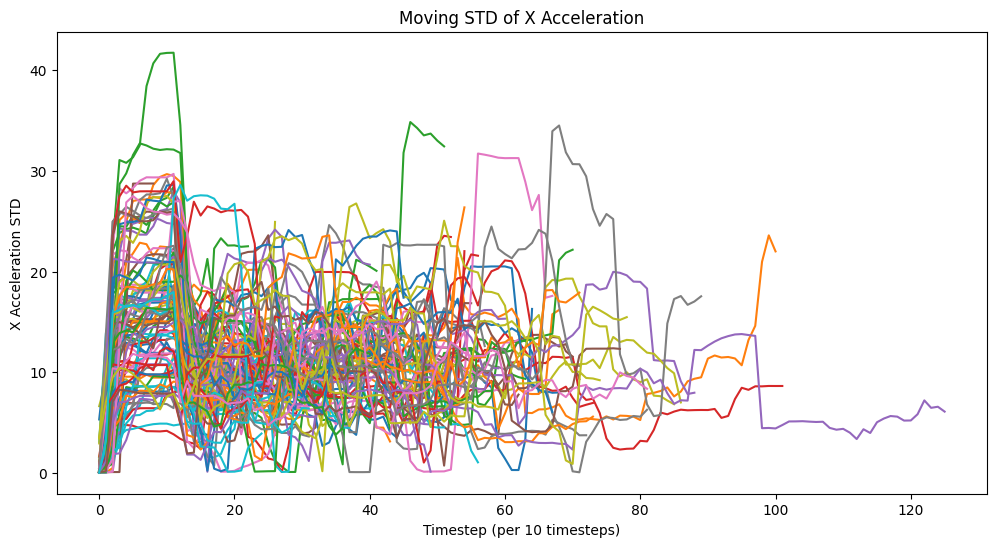

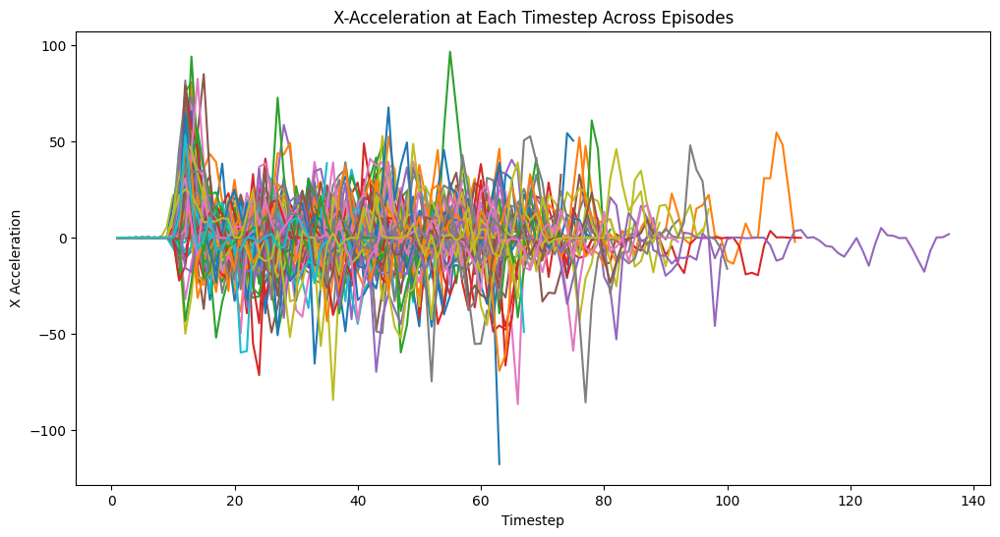

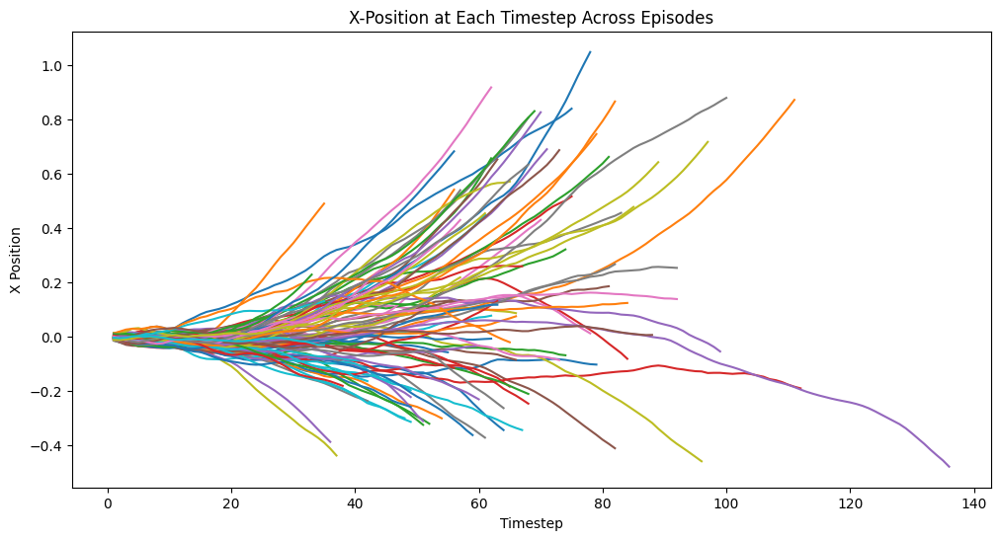

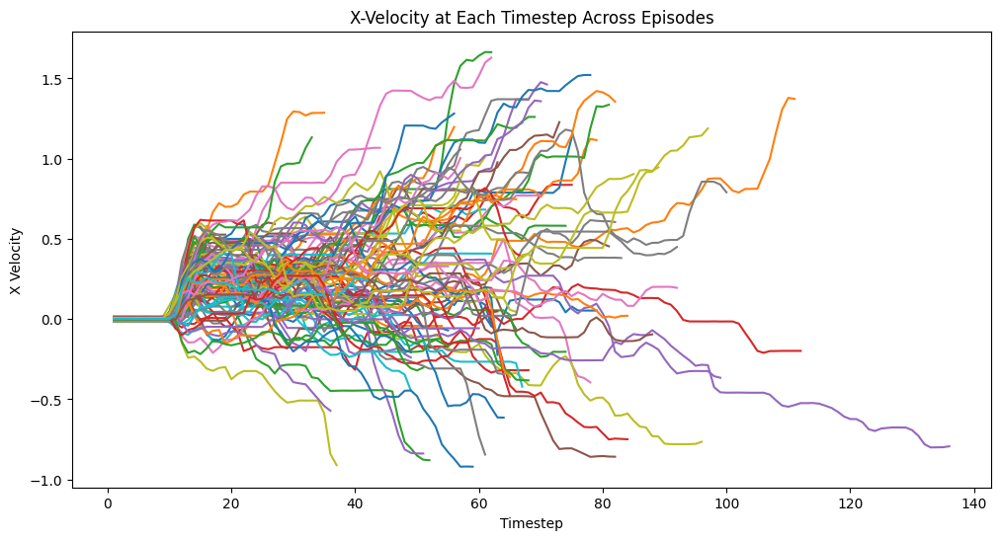

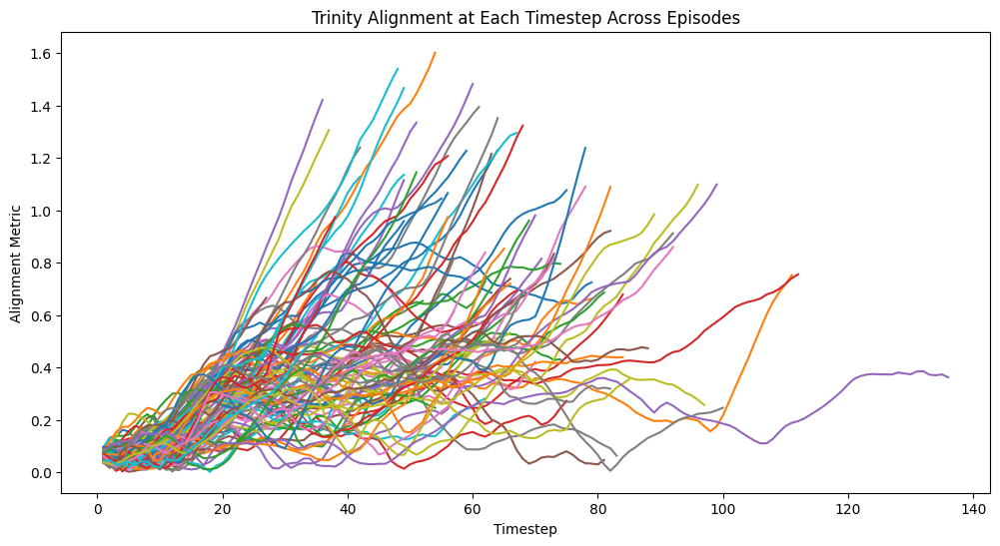

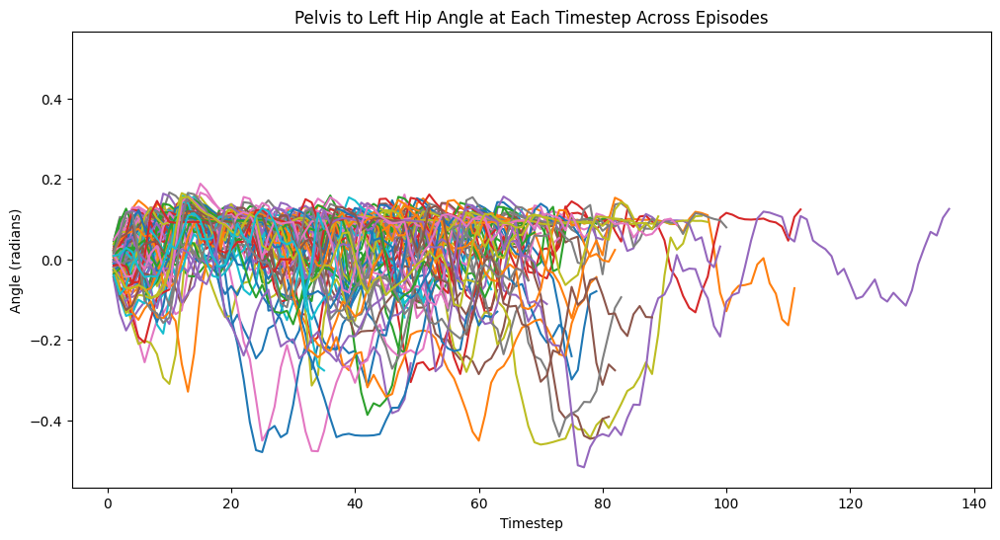

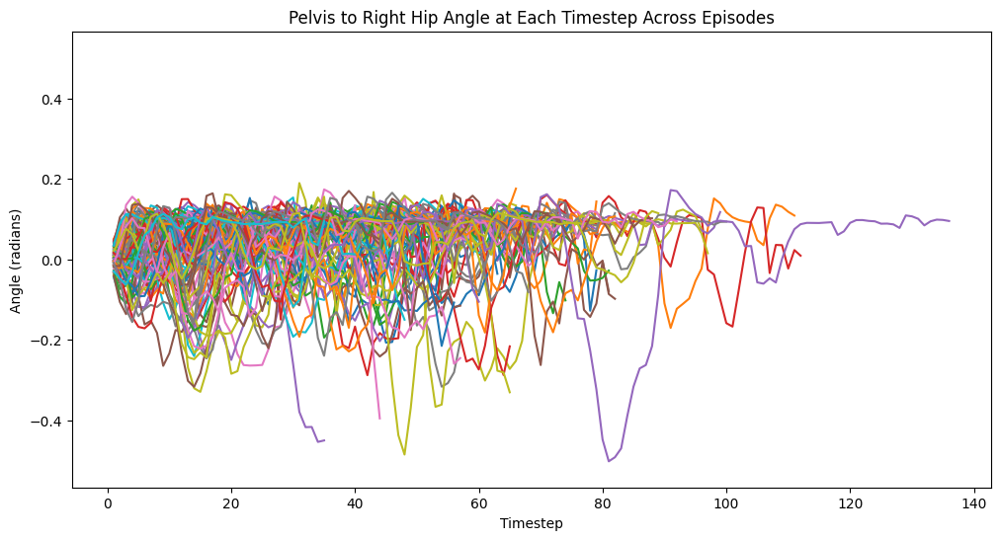

In [6]:
from stable_baselines3 import PPO
import gymnasium as gym
import matplotlib.pyplot as plt
import numpy as np  # Used for computing trend lines
import mujoco
from scipy.spatial.transform import Rotation as R  # For quaternion conversion

class CustomReward(gym.Wrapper):
    def __init__(self, env, torso_z_min):
        super().__init__(env)
        self.z_min = torso_z_min
        # Initialize last_x_velocity to 0.0 (or None if you prefer a conditional check)
        self.last_x_velocity = 0.0
        # Initialize a buffer for x_acceleration values with a moving window length of 10
        self.x_acc_buffer = []
        self.window_length = 10

    def reset(self, **kwargs):
        # When resetting the environment, also reset the last_x_velocity and the acceleration buffer.
        # Note: gymnasium's reset returns (obs, info)
        obs, info = self.env.reset(**kwargs)
        self.last_x_velocity = 0.0  # or you can set this to info["x_velocity"] if available
        self.x_acc_buffer = []  # reset the moving window
        return obs, info

    def step(self, action):
        # Step the environment and get the info dictionary
        obs, reward, done, truncated, info = self.env.step(action)
        
        # X acceleration (main body)
        dt = self.unwrapped.model.opt.timestep
        x_acceleration = (info["x_velocity"] - self.last_x_velocity) / dt
        self.last_x_velocity = info["x_velocity"]

        # Update moving window buffer for x_acceleration
        self.x_acc_buffer.append(x_acceleration)
        if len(self.x_acc_buffer) > self.window_length:
            self.x_acc_buffer.pop(0)

        # Pelvis tilt
        pelvis_id = mujoco.mj_name2id(
            self.env.unwrapped.model,
            mujoco.mjtObj.mjOBJ_BODY.value,
            "pelvis")
        quat = self.env.unwrapped.data.xquat[pelvis_id]
        pelvis_tilt = np.linalg.norm(quat[1:])

        # Torso height
        qpos = self.unwrapped.data.qpos
        torso_z = qpos[2]

        # --- Compute Trinity Alignment ---
        # Get body ids for torso, pelvis, left shin and right shin.
        torso_id = mujoco.mj_name2id(
            self.env.unwrapped.model,
            mujoco.mjtObj.mjOBJ_BODY.value,
            "torso")  # updated string from "torso_quat" to "torso"
        # Pelvis id is already computed above.
        lshin_id = mujoco.mj_name2id(
            self.env.unwrapped.model,
            mujoco.mjtObj.mjOBJ_BODY.value,
            "left_shin")
        rshin_id = mujoco.mj_name2id(
            self.env.unwrapped.model,
            mujoco.mjtObj.mjOBJ_BODY.value,
            "right_shin")

        # Get the x-coordinate of each body part using xipos.
        torso_x = self.env.unwrapped.data.xipos[torso_id, 0]
        pelvis_x = self.env.unwrapped.data.xipos[pelvis_id, 0]
        lshin_x = self.env.unwrapped.data.xipos[lshin_id, 0]
        rshin_x = self.env.unwrapped.data.xipos[rshin_id, 0]
        shins_x = (lshin_x + rshin_x) / 2

        # Compute the Trinity Alignment metric.
        trinity_alignment = (np.abs(torso_x - pelvis_x) +
                             np.abs(pelvis_x - shins_x) +
                             np.abs(shins_x - torso_x))
        info["trinity_alignment"] = trinity_alignment
        # --- End Trinity Alignment ---

        # Retrieve additional info values for reward computation
        survive = info["reward_survive"]
        forward = info["reward_forward"]
        ctrl = info["reward_ctrl"]
        contact = info["reward_contact"]
        x_position = info["x_position"]

        # Define your reward (customize coefficients as needed)
        reward = (0 * survive + 10 * forward)
        reward += 10 * x_position
        reward += 10 * (0.3 - pelvis_tilt)
        
        # Optionally, override the done flag if torso_z is above your minimum
        if torso_z >= self.z_min:
            done = False

        return obs, reward, done, truncated, info

# Create the environment and wrap it with the custom reward
env = gym.make("Humanoid-v5", render_mode="human")
env = CustomReward(env, torso_z_min=1)  # adjust torso_z_min as needed

# Retrieve the simulation timestep (dt) from the underlying MuJoCo model.
dt = env.unwrapped.model.opt.timestep

# Load the trained model (or create a new one)
# model = PPO("MlpPolicy", env)
model = PPO.load("Trinity_dancer_no_damp2", env=env)

num_episodes = 100  # Change this to run more episodes

# Lists to store per-episode statistics for the additional plots
episode_durations = []          # Duration (number of timesteps) per episode
episode_avg_x = []              # Average x-velocity per episode
episode_avg_x_acceleration = [] # Average x-acceleration per episode
sample_acc1 = []
sample_acc2 = []
sample_acc3 = []
episodes_rewards = []

# New lists for pelvis-to-hip angles per timestep (Right and Left)
angle_RL_over_episodes = []  # angle between pelvis and right hip
angle_LL_over_episodes = []  # angle between pelvis and left hip

for episode in range(num_episodes):
    obs, _ = env.reset()  # Reset environment
    done = False
    total_reward = 0
    ep_length = 0
    x_velocity = []         # X-velocity per timestep
    x_position = []         # X-position per timestep
    timesteps = []          # Timestep indices
    
    # Lists for pelvis-to-hip angles in this episode
    angle_RL_vals = []  # Right hip angle (from obs[8])
    angle_LL_vals = []  # Left hip angle (from obs[12])
    
    # List for Trinity Alignment per timestep
    trinity_alignments = []

    while not done:
        action, _states = model.predict(obs, deterministic=False)
        obs, reward, done, truncated, info = env.step(action)
        total_reward += reward
        ep_length += 1

        # Record metrics from the info dictionary
        x_velocity.append(info["x_velocity"])
        x_position.append(info["x_position"])
        timesteps.append(ep_length)
        
        # Record pelvis-to-hip angles from observation
        angle_RL_vals.append(obs[8])
        angle_LL_vals.append(obs[12])
        
        # Record Trinity Alignment from info
        trinity_alignments.append(info["trinity_alignment"])
        
        env.render()

    episodes_rewards.append(total_reward)
    
    # Compute x-acceleration using finite differences:
    x_acceleration = [0.0]
    for i in range(1, len(x_velocity)):
        acc = (x_velocity[i] - x_velocity[i-1]) / dt
        x_acceleration.append(acc)
        if (episode+1) == round(num_episodes/3):
            sample_acc1.append(acc)
        elif (episode+1) == round(2*(num_episodes/3)):
            sample_acc2.append(acc)
        elif (episode+1) == num_episodes:
            sample_acc3.append(acc)

    # Calculate average acceleration for the episode.
    avg_x_acc = np.mean(x_acceleration)
    x_acc_buffer = []
    for i in range(len(x_acceleration)-10):
        x_acc_buffer.append(np.std(x_acceleration[i:i+10]))

    # Plot the moving standard deviation of x-acceleration (per 10 timesteps)
    plt.figure("X_acc_moving_std", figsize=(12,6))
    plt.plot(range(len(x_acc_buffer)), x_acc_buffer, label=f"Episode {episode+1}")

    print(f"Episode {episode + 1}: Total Reward = {total_reward}, duration = {ep_length}")
    
    # Plot X-Position per episode
    plt.figure("X-Position", figsize=(12,6))
    plt.plot(timesteps, x_position, label=f"Episode {episode+1}")

    # Plot X-Velocity per episode
    plt.figure("X-Velocity", figsize=(12,6))
    plt.plot(timesteps, x_velocity, label=f"Episode {episode+1}")
    
    # Plot X-Acceleration per episode
    plt.figure("X-Acceleration", figsize=(12,6))
    plt.plot(timesteps, x_acceleration, label=f"Episode {episode+1}")
    
    # Plot Pelvis to Left Hip Angle per episode with dynamic ylim.
    plt.figure("Pelvis-Left Hip Angle", figsize=(12,6))
    plt.plot(timesteps, angle_LL_vals, label=f"Episode {episode+1}")

    # Plot Pelvis to Right Hip Angle per episode with dynamic ylim.
    plt.figure("Pelvis-Right Hip Angle", figsize=(12,6))
    plt.plot(timesteps, angle_RL_vals, label=f"Episode {episode+1}")
    
    # Plot Trinity Alignment per episode
    plt.figure("Trinity Alignment", figsize=(12,6))
    plt.plot(timesteps, trinity_alignments, label=f"Episode {episode+1}")
    
    # Calculate and store average velocities, acceleration, and episode duration
    avg_x = np.mean(x_velocity) if x_velocity else 0
    episode_durations.append(ep_length)
    episode_avg_x.append(avg_x)
    episode_avg_x_acceleration.append(avg_x_acc)

    # Store pelvis-to-hip angles over episodes:
    angle_RL_over_episodes.append(angle_RL_vals)
    angle_LL_over_episodes.append(angle_LL_vals)

print(f'EPISODE LENGTH AVERAGE: {np.mean(episode_durations)}, EPISODE LENGTH STD: {np.std(episode_durations)}')
print(f'Mean Episode Reward: {np.mean(episodes_rewards)}')
env.close()

# Compute dynamic y-limit across all episodes for pelvis-to-hip angles.
limit_rl = np.max([np.max(np.abs(angles)) for angles in angle_RL_over_episodes if len(angles) > 0])
limit_ll = np.max([np.max(np.abs(angles)) for angles in angle_LL_over_episodes if len(angles) > 0])
limit = max(limit_rl, limit_ll) + 0.05

# Finalize and show all plots

plt.figure("X_acc_moving_std")
plt.xlabel("Timestep (per 10 timesteps)")
plt.ylabel("X Acceleration STD")
plt.title("Moving STD of X Acceleration")

plt.figure("X-Acceleration")
plt.xlabel("Timestep")
plt.ylabel("X Acceleration")
plt.title("X-Acceleration at Each Timestep Across Episodes")

plt.figure("X-Position")
plt.xlabel("Timestep")
plt.ylabel("X Position")
plt.title("X-Position at Each Timestep Across Episodes")

plt.figure("X-Velocity")
plt.xlabel("Timestep")
plt.ylabel("X Velocity")
plt.title("X-Velocity at Each Timestep Across Episodes")

plt.figure("Trinity Alignment")
plt.xlabel("Timestep")
plt.ylabel("Alignment Metric")
plt.title("Trinity Alignment at Each Timestep Across Episodes")

plt.figure("Pelvis-Left Hip Angle", figsize=(12,6))
plt.xlabel("Timestep")
plt.ylabel("Angle (radians)")
plt.title("Pelvis to Left Hip Angle at Each Timestep Across Episodes")
plt.ylim(-limit, limit)

plt.figure("Pelvis-Right Hip Angle", figsize=(12,6))
plt.xlabel("Timestep")
plt.ylabel("Angle (radians)")
plt.title("Pelvis to Right Hip Angle at Each Timestep Across Episodes")
plt.ylim(-limit, limit)

plt.show()

In [59]:
ctrl=env.unwrapped.data.ctrl
print(np.mean(np.abs(ctrl)))
print(np.std(ctrl))

0.005116607524755904
0.006981399135531478


Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
Episode 1: Total Reward = 447.35408793231767, Duration = 84 timesteps
Episode 2: Total Reward = 560.9031828563533, Duration = 99 timesteps
Episode 3: Total Reward = 522.1538850849083, Duration = 92 timesteps
Episode 4: Total Reward = 551.7644972498565, Duration = 95 timesteps
Episode 5: Total Reward = 480.50665586730486, Duration = 86 timesteps
Episode 6: Total Reward = 636.8352215029885, Duration = 107 timesteps
Episode 7: Total Reward = 524.5607473212311, Duration = 98 timesteps
Episode 8: Total Reward = 596.0018599399781, Duration = 99 timesteps
Episode 9: Total Reward = 562.7256446274636, Duration = 96 timesteps
Episode 10: Total Reward = 530.3769832414042, Duration = 87 timesteps
Episode 11: Total Reward = 536.0356147756364, Duration = 89 timesteps
Episode 12: Total Reward = 551.7687078725954, Duration = 93 timesteps
Episode 13: Total Reward = 621.7911624291951, Duration = 104 timesteps
Episode 14: Total 

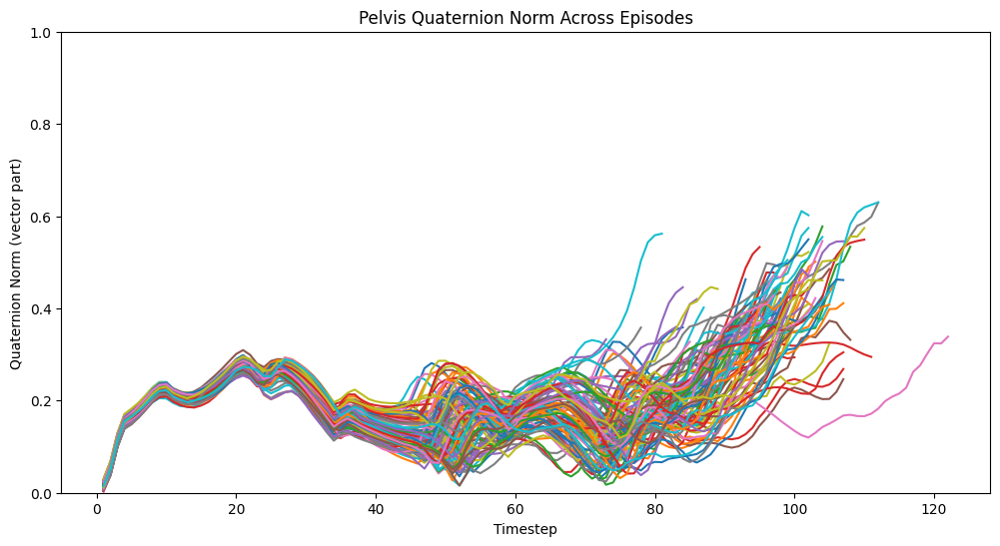

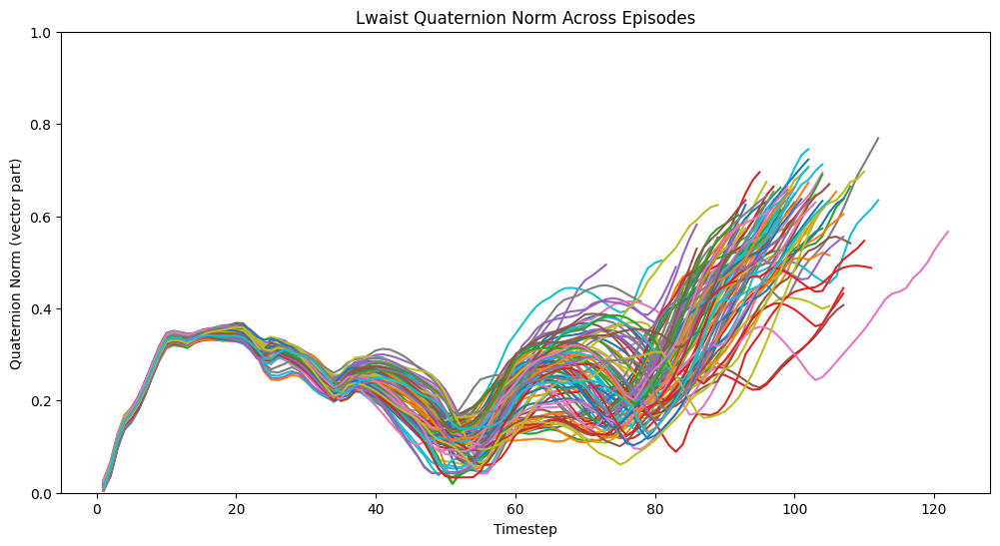

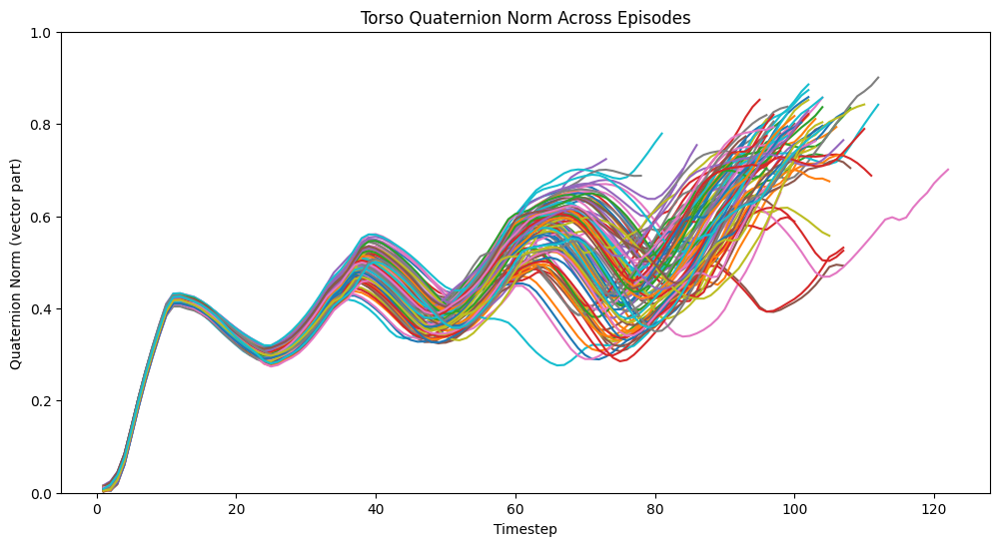

In [37]:
import mujoco  # New official MuJoCo Python bindings
from stable_baselines3 import PPO
import gymnasium as gym
import matplotlib.pyplot as plt
import numpy as np
import torch.nn as nn

def extract_body_info(env, body_name):
    """
    Extract the quaternion for the given body using the new MuJoCo API and compute the norm
    of its vector part (i.e., the Euclidean norm of [x, y, z]).
    """
    # Use the new API to get the body id.
    body_id = mujoco.mj_name2id(env.unwrapped.model, mujoco.mjtObj.mjOBJ_BODY.value, body_name)
    # Retrieve the quaternion for that body; xquat is assumed to be an array with quaternions [w, x, y, z]
    quat = env.unwrapped.data.xquat[body_id]
    # Compute and return the norm of the vector part (x, y, z)
    return np.linalg.norm(quat[1:])

# Create the environment (Humanoid-v5 is assumed to be a MuJoCo-based environment)
env = gym.make("Humanoid-v5", render_mode="human")


model = PPO.load("spicy_vanilla_tilt_vs_forward4", env=env)

num_episodes = 100  # Number of episodes to run

# Lists to store episode statistics (for additional plotting if needed)
episode_durations = []  # Episode lengths (in timesteps)
episode_avg_x = []      # Average x-velocity per episode
episode_avg_y = []      # Average y-velocity per episode

for episode in range(num_episodes):
    obs, _ = env.reset()  # Reset the environment
    done = False
    total_reward = 0
    ep_length = 0
    x_velocity = []
    y_velocity = []
    timesteps = []
    
    # Lists to track quaternion norms for specified bodies
    pelvis_norms = []
    lwaist_norms = []
    torso_norms = []
    
    while not done:
        # Get the action from the trained model (deterministic policy)
        action, _states = model.predict(obs, deterministic=True)
        obs, reward, done, truncated, info = env.step(action)
        total_reward += reward
        ep_length += 1
        timesteps.append(ep_length)
        
        # Record velocity info (defaulting to 0 if not provided)
        x_velocity.append(info.get("x_velocity", 0))
        y_velocity.append(info.get("y_velocity", 0))
        
        # Extract quaternion norms using the new API call
        pelvis_norms.append(extract_body_info(env, "pelvis"))
        lwaist_norms.append(extract_body_info(env, "lwaist"))
        torso_norms.append(extract_body_info(env, "torso"))
        
        env.render()

    print(f"Episode {episode + 1}: Total Reward = {total_reward}, Duration = {ep_length} timesteps")
    
    # Plot the quaternion norms for this episode
    plt.figure("Pelvis Quaternion Norm", figsize=(12, 6))
    plt.plot(timesteps, pelvis_norms, label=f"Episode {episode + 1}")

    plt.figure("Lwaist Quaternion Norm", figsize=(12, 6))
    plt.plot(timesteps, lwaist_norms, label=f"Episode {episode + 1}")
    
    plt.figure("Torso Quaternion Norm", figsize=(12, 6))
    plt.plot(timesteps, torso_norms, label=f"Episode {episode + 1}")
    
    # Compute and store average velocities for the episode (if needed)
    avg_x = np.mean(x_velocity) if x_velocity else 0
    avg_y = np.mean(y_velocity) if y_velocity else 0
    episode_durations.append(ep_length)
    episode_avg_x.append(avg_x)
    episode_avg_y.append(avg_y)

env.close()

# Customize and display the quaternion norm plots
plt.figure("Pelvis Quaternion Norm")
plt.xlabel("Timestep")
plt.ylabel("Quaternion Norm (vector part)")
plt.ylim(0,1)
plt.title("Pelvis Quaternion Norm Across Episodes")


plt.figure("Lwaist Quaternion Norm")
plt.xlabel("Timestep")
plt.ylabel("Quaternion Norm (vector part)")
plt.ylim(0,1)
plt.title("Lwaist Quaternion Norm Across Episodes")


plt.figure("Torso Quaternion Norm")
plt.xlabel("Timestep")
plt.ylabel("Quaternion Norm (vector part)")
plt.ylim(0,1)
plt.title("Torso Quaternion Norm Across Episodes")


plt.show()

In [2]:
print(dir(env.unwrapped))

['__annotations__', '__class__', '__class_getitem__', '__delattr__', '__dict__', '__dir__', '__doc__', '__enter__', '__eq__', '__exit__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__orig_bases__', '__parameters__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__setstate__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', '_contact_cost_range', '_contact_cost_weight', '_ctrl_cost_weight', '_exclude_current_positions_from_observation', '_ezpickle_args', '_ezpickle_kwargs', '_forward_reward_weight', '_get_obs', '_get_reset_info', '_get_rew', '_healthy_reward', '_healthy_z_range', '_include_cfrc_ext_in_observation', '_include_cinert_in_observation', '_include_cvel_in_observation', '_include_qfrc_actuator_in_observation', '_initialize_simulation', '_np_random', '_np_random_seed', '_reset_noise_scale', '_set_action_space', '_step_mujoco_si

In [12]:
def quat_to_rotmat(quat):
    """
    Convert a quaternion (assumed in [w, x, y, z] order) to a 3x3 rotation matrix.
    """
    w, x, y, z = quat
    return np.array([
        [1 - 2*y**2 - 2*z**2,   2*x*y - 2*z*w,       2*x*z + 2*y*w],
        [2*x*y + 2*z*w,         1 - 2*x**2 - 2*z**2,   2*y*z - 2*x*w],
        [2*x*z - 2*y*w,         2*y*z + 2*x*w,         1 - 2*x**2 - 2*y**2]
    ])

def compute_knee_pos(env, thigh_name, local_offset):
    """
    Estimate the global knee position based on the thigh's global position and orientation.
    
    Parameters:
      env          : The MuJoCo environment.
      thigh_name   : The name of the thigh body ("right_thigh" or "left_thigh").
      local_offset : A 3D numpy array representing the desired offset in the thigh's local frame.
                     For example, for the right thigh, use [0, 0.01, -0.34] as defined by the
                     capsule geometry's 'fromto' attribute.
    
    Returns:
      knee_pos     : The estimated global position of the knee.
    """
    body_id = mujoco.mj_name2id(env.unwrapped.model, mujoco.mjtObj.mjOBJ_BODY.value, thigh_name)
    thigh_pos = env.unwrapped.data.xipos[body_id]
    thigh_quat = env.unwrapped.data.xquat[body_id]
    R = quat_to_rotmat(thigh_quat)
    knee_pos = thigh_pos + R.dot(local_offset)
    return knee_pos

# Shin Baseline

Episode 1 finished in 17 timesteps.
Episode 2 finished in 28 timesteps.
Episode 3 finished in 21 timesteps.
Episode 4 finished in 35 timesteps.
Episode 5 finished in 24 timesteps.
Episode 6 finished in 31 timesteps.
Episode 7 finished in 20 timesteps.
Episode 8 finished in 21 timesteps.
Episode 9 finished in 18 timesteps.
Episode 10 finished in 23 timesteps.
Episode 11 finished in 18 timesteps.
Episode 12 finished in 42 timesteps.
Episode 13 finished in 31 timesteps.
Episode 14 finished in 19 timesteps.
Episode 15 finished in 17 timesteps.
Episode 16 finished in 22 timesteps.
Episode 17 finished in 41 timesteps.
Episode 18 finished in 24 timesteps.
Episode 19 finished in 24 timesteps.
Episode 20 finished in 18 timesteps.
Episode 21 finished in 23 timesteps.
Episode 22 finished in 18 timesteps.
Episode 23 finished in 21 timesteps.
Episode 24 finished in 18 timesteps.
Episode 25 finished in 26 timesteps.
Episode 26 finished in 22 timesteps.
Episode 27 finished in 18 timesteps.
Episode 28

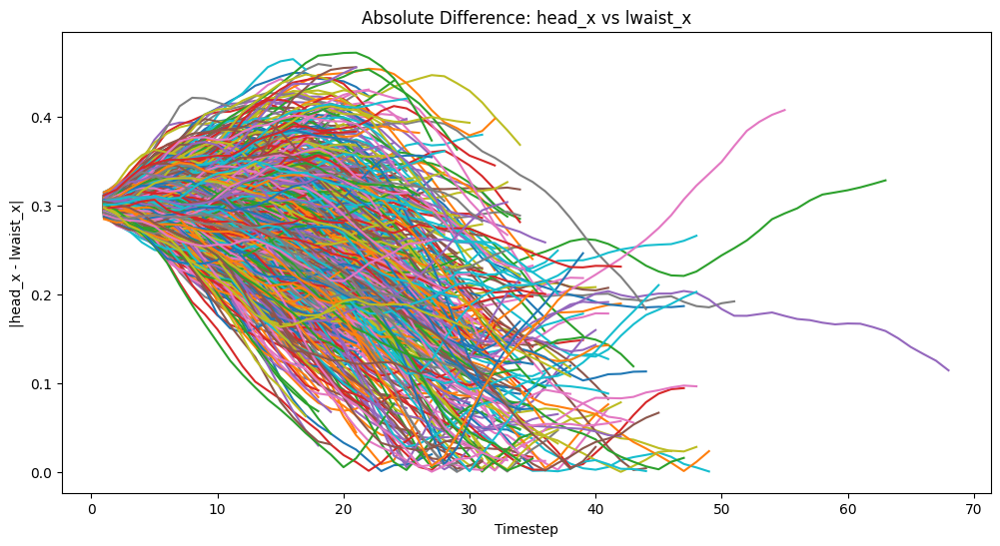

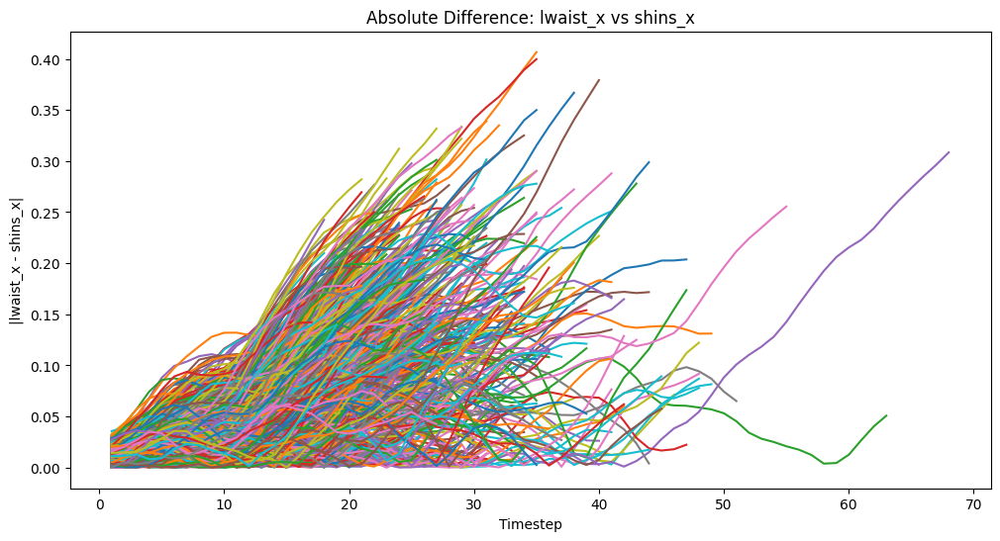

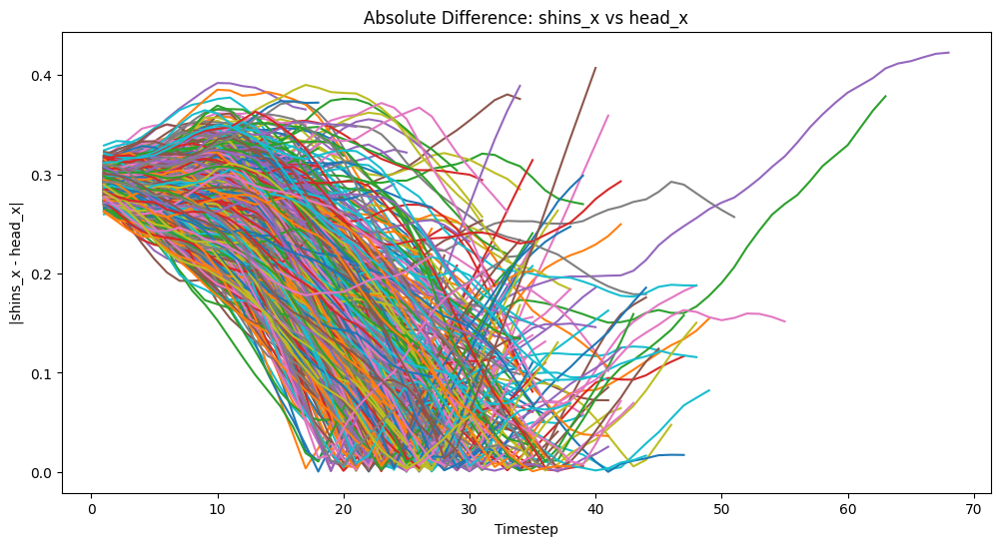

In [19]:
import gymnasium as gym
import numpy as np
from stable_baselines3 import PPO
import matplotlib.pyplot as plt
import mujoco  # make sure you have the proper mujoco bindings installed

def get_body_x(env, body_name):
    """
    Extract the x-coordinate (index 0 of the position vector)
    of a given body in the MuJoCo environment.
    """
    body_id = mujoco.mj_name2id(env.unwrapped.model, mujoco.mjtObj.mjOBJ_BODY.value, body_name)
    pos = env.unwrapped.data.xipos[body_id]
    return pos[0]

# Create the environment; using render_mode "human" if you want to see it running.
env = gym.make("Humanoid-v5", render_mode="human", healthy_z_range=(1.0, 2.0))
model = PPO("MlpPolicy", env)
num_episodes = 1000

# These lists will store the per-episode time series for each difference.
all_timesteps = []
all_diff_head_lwaist = []  # |head_x - lwaist_x|
all_diff_lwaist_shins = [] # |lwaist_x - shins_x|
all_diff_shins_head = []   # |shins_x - head_x|

for ep in range(num_episodes):
    obs, _ = env.reset()
    done = False
    truncated = False
    timestep = 0

    # Per-episode lists to record timesteps and differences.
    ep_timesteps = []
    ep_diff_head_lwaist = []
    ep_diff_lwaist_shins = []
    ep_diff_shins_head = []

    while not (done or truncated):
        # For a baseline, we just sample a random action.
        action = env.action_space.sample()
        obs, reward, done, truncated, info = env.step(action)
        timestep += 1
        ep_timesteps.append(timestep)
        
        # Extract the x-coordinate for each body.
        
        head_x = get_body_x(env, "head")
        lwaist_x = get_body_x(env, "lwaist")
        # Access left_shin and right_shin separately and compute their mean.
        lshin_x = get_body_x(env, "left_shin")
        rshin_x = get_body_x(env, "right_shin")
        shins_x = (lshin_x + rshin_x) / 2.0
        

        # Calculate the absolute differences.
        diff1 = np.abs(head_x - lwaist_x)
        diff2 = np.abs(lwaist_x - shins_x)
        diff3 = np.abs(shins_x - head_x)
        
        ep_diff_head_lwaist.append(diff1)
        ep_diff_lwaist_shins.append(diff2)
        ep_diff_shins_head.append(diff3)
        
        env.render()

    # Store episode data.
    all_timesteps.append(ep_timesteps)
    all_diff_head_lwaist.append(ep_diff_head_lwaist)
    all_diff_lwaist_shins.append(ep_diff_lwaist_shins)
    all_diff_shins_head.append(ep_diff_shins_head)
    print(f"Episode {ep + 1} finished in {timestep} timesteps.")

env.close()

# Now plot the differences from all episodes (no legends, per request)
plt.figure(figsize=(12, 6))
for i in range(num_episodes):
    plt.plot(all_timesteps[i], all_diff_head_lwaist[i])
plt.xlabel("Timestep")
plt.ylabel("|head_x - lwaist_x|")
plt.title("Absolute Difference: head_x vs lwaist_x")

plt.figure(figsize=(12, 6))
for i in range(num_episodes):
    plt.plot(all_timesteps[i], all_diff_lwaist_shins[i])
plt.xlabel("Timestep")
plt.ylabel("|lwaist_x - shins_x|")
plt.title("Absolute Difference: lwaist_x vs shins_x")

plt.figure(figsize=(12, 6))
for i in range(num_episodes):
    plt.plot(all_timesteps[i], all_diff_shins_head[i])
plt.xlabel("Timestep")
plt.ylabel("|shins_x - head_x|")
plt.title("Absolute Difference: shins_x vs head_x")

plt.show()

# Knee Baseline

Episode 1 finished in 22 timesteps.
Episode 2 finished in 17 timesteps.
Episode 3 finished in 29 timesteps.
Episode 4 finished in 20 timesteps.
Episode 5 finished in 17 timesteps.
Episode 6 finished in 20 timesteps.
Episode 7 finished in 17 timesteps.
Episode 8 finished in 36 timesteps.
Episode 9 finished in 23 timesteps.
Episode 10 finished in 25 timesteps.
Episode 11 finished in 19 timesteps.
Episode 12 finished in 18 timesteps.
Episode 13 finished in 17 timesteps.
Episode 14 finished in 18 timesteps.
Episode 15 finished in 19 timesteps.
Episode 16 finished in 20 timesteps.
Episode 17 finished in 32 timesteps.
Episode 18 finished in 19 timesteps.
Episode 19 finished in 18 timesteps.
Episode 20 finished in 20 timesteps.
Episode 21 finished in 18 timesteps.
Episode 22 finished in 19 timesteps.
Episode 23 finished in 19 timesteps.
Episode 24 finished in 34 timesteps.
Episode 25 finished in 20 timesteps.
Episode 26 finished in 34 timesteps.
Episode 27 finished in 18 timesteps.
Episode 28

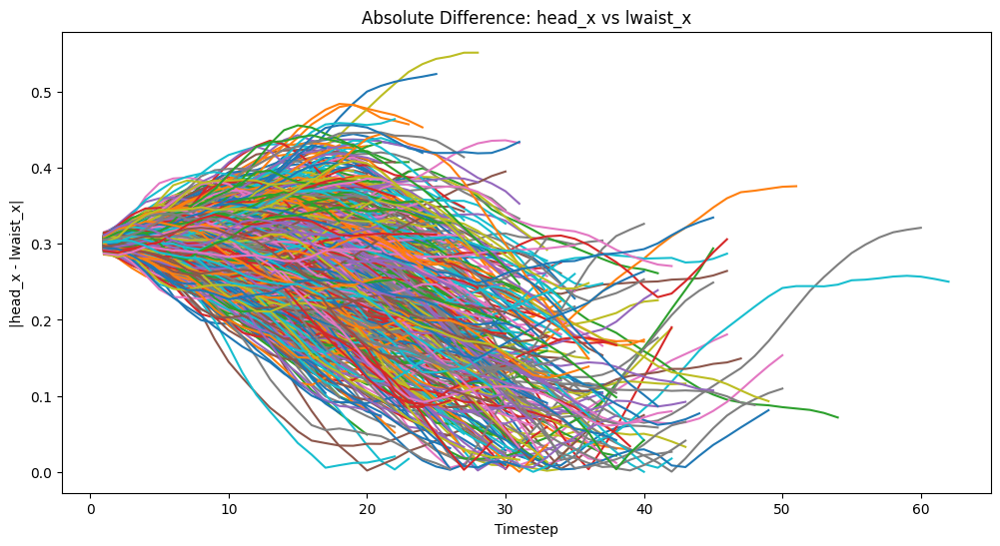

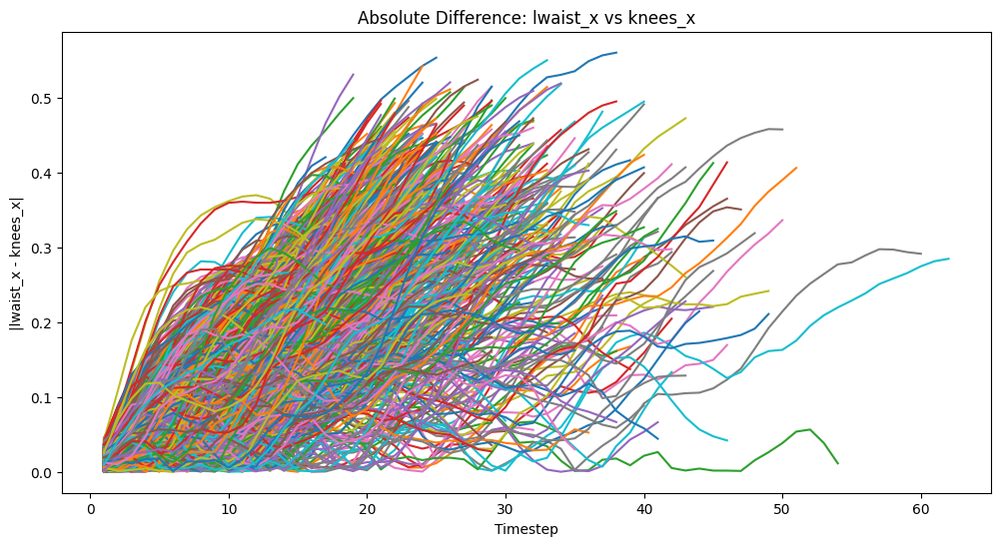

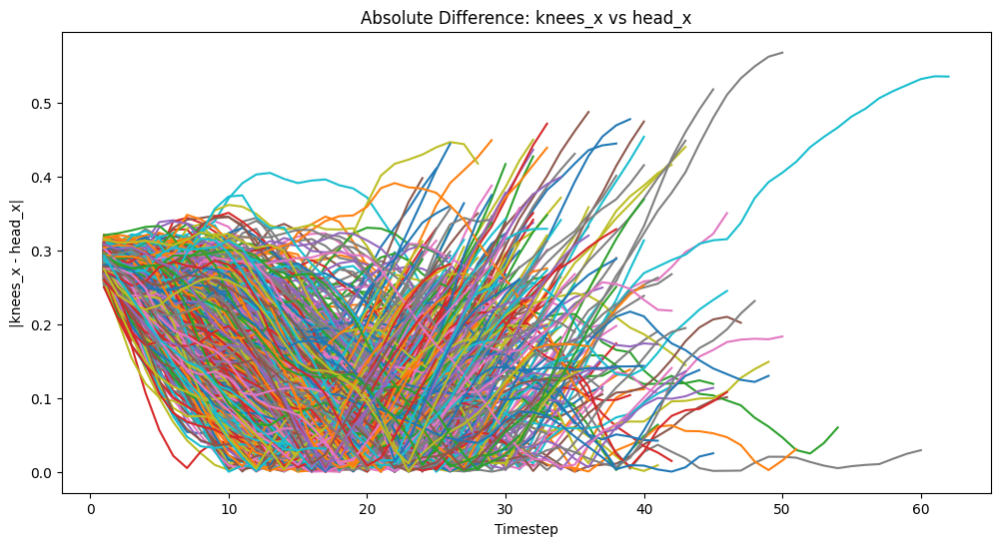

In [18]:
import gymnasium as gym
import numpy as np
from stable_baselines3 import PPO
import matplotlib.pyplot as plt
import mujoco  # make sure you have the proper mujoco bindings installed

def get_body_x(env, body_name):
    """
    Extract the x-coordinate (index 0 of the position vector)
    of a given body in the MuJoCo environment.
    
    For knee bodies ("left_knee" or "right_knee"), it uses the compute_knee_pos
    function with a predefined local offset based on the model's geometry.
    """
    if body_name == "left_knee":
        # The XML defines the left thigh's capsule fromto as "0 0 0 0 -0.01 -0.34".
        # This implies the local offset for the knee relative to left_thigh is:
        local_offset = np.array([0, -0.01, -0.34])
        knee_pos = compute_knee_pos(env, "left_thigh", local_offset)
        return knee_pos[0]
    elif body_name == "right_knee":
        # The XML defines the right thigh's capsule fromto as "0 0 0 0 0.01 -0.34".
        # Thus the local offset for the knee relative to right_thigh is:
        local_offset = np.array([0, 0.01, -0.34])
        knee_pos = compute_knee_pos(env, "right_thigh", local_offset)
        return knee_pos[0]
    else:
        # For other bodies, simply retrieve the global position from xipos.
        body_id = mujoco.mj_name2id(env.unwrapped.model, mujoco.mjtObj.mjOBJ_BODY.value, body_name)
        pos = env.unwrapped.data.xipos[body_id]
        return pos[0]

# --- Assume the functions quat_to_rotmat and compute_knee_pos are defined as before --- #

# Create the environment; using render_mode "human" if you want to see it running.
env = gym.make("Humanoid-v5", render_mode="human", healthy_z_range=(1.0, 2.0))
model = PPO("MlpPolicy", env)
num_episodes = 1000

# These lists will store the per-episode time series for each difference.
all_timesteps = []
all_diff_head_lwaist = []  # |head_x - lwaist_x|
all_diff_lwaist_knees = []  # |lwaist_x - knees_x|
all_diff_knees_head = []    # |knees_x - head_x|

for ep in range(num_episodes):
    obs, _ = env.reset()
    done = False
    truncated = False
    timestep = 0

    # Per-episode lists to record timesteps and differences.
    ep_timesteps = []
    ep_diff_head_lwaist = []
    ep_diff_lwaist_knees = []
    ep_diff_knees_head = []

    while not (done or truncated):
        # For a baseline, we just sample a random action.
        action = env.action_space.sample()
        obs, reward, done, truncated, info = env.step(action)
        timestep += 1
        ep_timesteps.append(timestep)
        
        # Extract the x-coordinate for each body.
        head_x = get_body_x(env, "head")
        lwaist_x = get_body_x(env, "lwaist")
        left_knee_x = get_body_x(env, "left_knee")
        right_knee_x = get_body_x(env, "right_knee")
        knees_x = (left_knee_x + right_knee_x) / 2.0
        
        # Calculate the absolute differences.
        diff1 = np.abs(head_x - lwaist_x)
        diff2 = np.abs(lwaist_x - knees_x)
        diff3 = np.abs(knees_x - head_x)
        
        ep_diff_head_lwaist.append(diff1)
        ep_diff_lwaist_knees.append(diff2)
        ep_diff_knees_head.append(diff3)
        
        env.render()

    # Store episode data.
    all_timesteps.append(ep_timesteps)
    all_diff_head_lwaist.append(ep_diff_head_lwaist)
    all_diff_lwaist_knees.append(ep_diff_lwaist_knees)
    all_diff_knees_head.append(ep_diff_knees_head)
    print(f"Episode {ep + 1} finished in {timestep} timesteps.")

env.close()

# Now plot the differences from all episodes (no legends, per request)
plt.figure(figsize=(12, 6))
for i in range(num_episodes):
    plt.plot(all_timesteps[i], all_diff_head_lwaist[i])
plt.xlabel("Timestep")
plt.ylabel("|head_x - lwaist_x|")
plt.title("Absolute Difference: head_x vs lwaist_x")

plt.figure(figsize=(12, 6))
for i in range(num_episodes):
    plt.plot(all_timesteps[i], all_diff_lwaist_knees[i])
plt.xlabel("Timestep")
plt.ylabel("|lwaist_x - knees_x|")
plt.title("Absolute Difference: lwaist_x vs knees_x")

plt.figure(figsize=(12, 6))
for i in range(num_episodes):
    plt.plot(all_timesteps[i], all_diff_knees_head[i])
plt.xlabel("Timestep")
plt.ylabel("|knees_x - head_x|")
plt.title("Absolute Difference: knees_x vs head_x")

plt.show()

# First Limper

Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
Episode 1 finished in 58 timesteps.
Episode 2 finished in 64 timesteps.
Episode 3 finished in 55 timesteps.
Episode 4 finished in 63 timesteps.
Episode 5 finished in 65 timesteps.
Episode 6 finished in 57 timesteps.
Episode 7 finished in 60 timesteps.
Episode 8 finished in 67 timesteps.
Episode 9 finished in 61 timesteps.
Episode 10 finished in 60 timesteps.
Episode 11 finished in 72 timesteps.
Episode 12 finished in 69 timesteps.
Episode 13 finished in 61 timesteps.
Episode 14 finished in 69 timesteps.
Episode 15 finished in 60 timesteps.
Episode 16 finished in 58 timesteps.
Episode 17 finished in 44 timesteps.
Episode 18 finished in 55 timesteps.
Episode 19 finished in 56 timesteps.
Episode 20 finished in 60 timesteps.
Episode 21 finished in 61 timesteps.
Episode 22 finished in 40 timesteps.
Episode 23 finished in 56 timesteps.
Episode 24 finished in 41 timesteps.
Episode 25 finished in 55 timesteps.
Episode

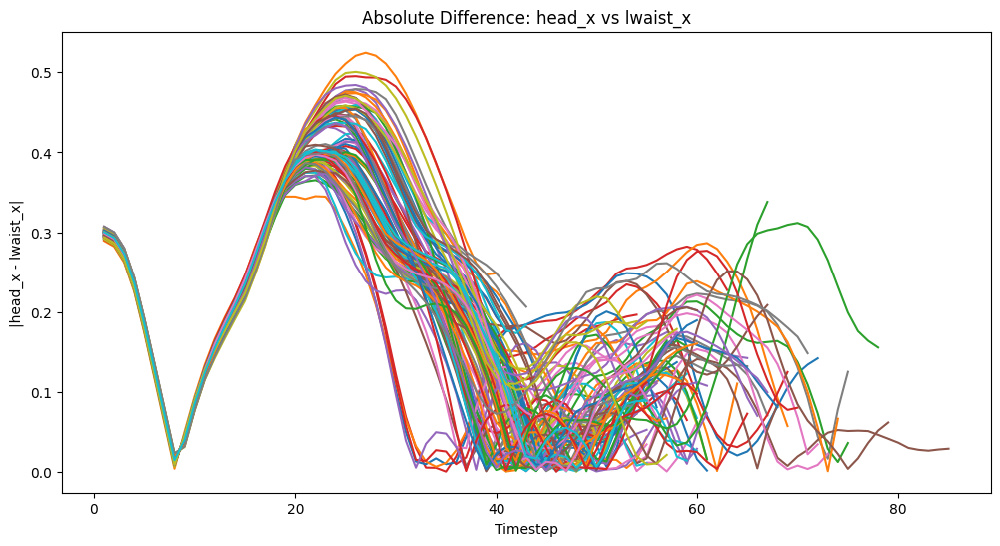

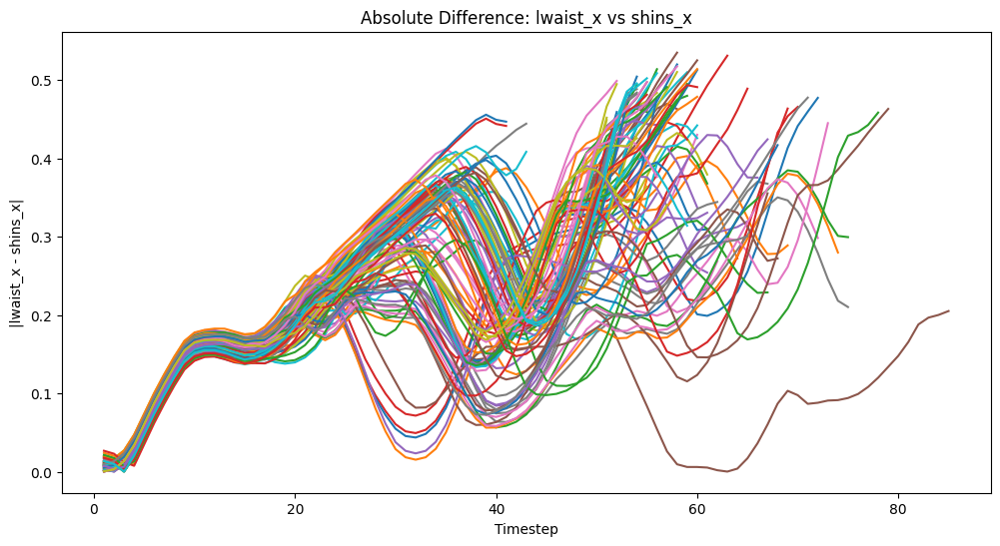

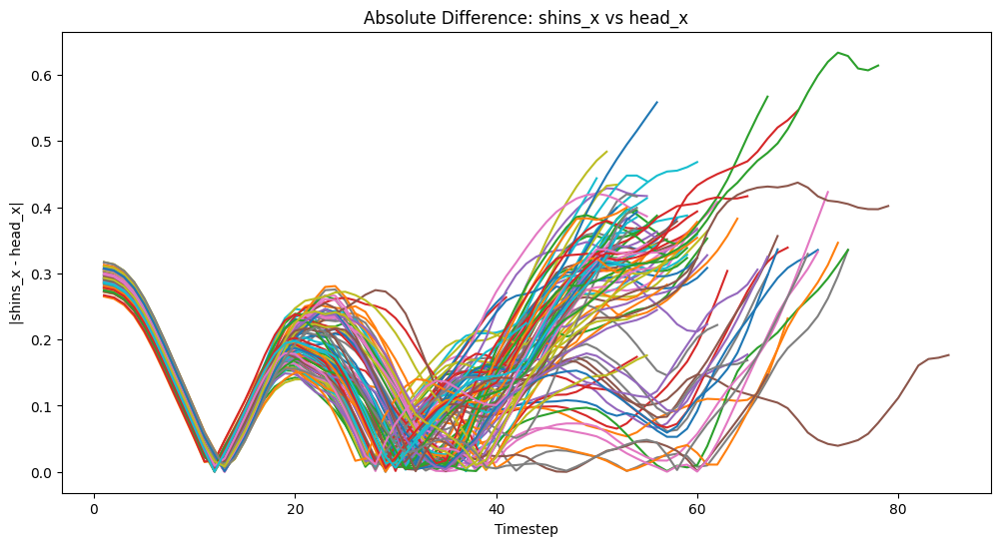

In [86]:
import gymnasium as gym
import numpy as np
from stable_baselines3 import PPO
import matplotlib.pyplot as plt
import mujoco  # make sure you have the proper mujoco bindings installed

def get_body_x(env, body_name):
    """
    Extract the x-coordinate (index 0 of the position vector)
    of a given body in the MuJoCo environment.
    """
    body_id = mujoco.mj_name2id(env.unwrapped.model, mujoco.mjtObj.mjOBJ_BODY.value, body_name)
    pos = env.unwrapped.data.xipos[body_id]
    return pos[0]

# Create the environment; using render_mode "human" if you want to see it running.
env = gym.make("Humanoid-v5", render_mode="human")

# Load your trained model.
model = PPO.load("spicy_walker", env=env)       
num_episodes = 100

# These lists will store the per-episode time series for each difference.
all_timesteps = []
all_diff_head_lwaist = []  # |head_x - lwaist_x|
all_diff_lwaist_shins = [] # |lwaist_x - shins_x|
all_diff_shins_head = []   # |shins_x - head_x|

for ep in range(num_episodes):
    obs, _ = env.reset()
    done = False
    truncated = False
    timestep = 0

    # Per-episode lists to record timesteps and differences.
    ep_timesteps = []
    ep_diff_head_lwaist = []
    ep_diff_lwaist_shins = []
    ep_diff_shins_head = []

    while not (done or truncated):
        # Use the trained model's prediction instead of sampling random actions.
        action, _states = model.predict(obs, deterministic=True)
        obs, reward, done, truncated, info = env.step(action)
        timestep += 1
        ep_timesteps.append(timestep)
        
        # Extract the x-coordinate for each body.
        try:
            head_x = get_body_x(env, "head")
            lwaist_x = get_body_x(env, "lwaist")
            # Access left_shin and right_shin separately and compute their mean.
            lshin_x = get_body_x(env, "left_shin")
            rshin_x = get_body_x(env, "right_shin")
            shins_x = (lshin_x + rshin_x) / 2.0
        except Exception as e:
            print(f"Error extracting body info: {e}")
            head_x = lwaist_x = shins_x = 0

        # Calculate the absolute differences.
        diff1 = np.abs(head_x - lwaist_x)
        diff2 = np.abs(lwaist_x - shins_x)
        diff3 = np.abs(shins_x - head_x)
        
        ep_diff_head_lwaist.append(diff1)
        ep_diff_lwaist_shins.append(diff2)
        ep_diff_shins_head.append(diff3)
        
        env.render()

    # Store episode data.
    all_timesteps.append(ep_timesteps)
    all_diff_head_lwaist.append(ep_diff_head_lwaist)
    all_diff_lwaist_shins.append(ep_diff_lwaist_shins)
    all_diff_shins_head.append(ep_diff_shins_head)
    print(f"Episode {ep + 1} finished in {timestep} timesteps.")

env.close()

# Now plot the differences from all episodes (no legends, per request)
plt.figure(figsize=(12, 6))
for i in range(num_episodes):
    plt.plot(all_timesteps[i], all_diff_head_lwaist[i])
plt.xlabel("Timestep")
plt.ylabel("|head_x - lwaist_x|")
plt.title("Absolute Difference: head_x vs lwaist_x")

plt.figure(figsize=(12, 6))
for i in range(num_episodes):
    plt.plot(all_timesteps[i], all_diff_lwaist_shins[i])
plt.xlabel("Timestep")
plt.ylabel("|lwaist_x - shins_x|")
plt.title("Absolute Difference: lwaist_x vs shins_x")

plt.figure(figsize=(12, 6))
for i in range(num_episodes):
    plt.plot(all_timesteps[i], all_diff_shins_head[i])
plt.xlabel("Timestep")
plt.ylabel("|shins_x - head_x|")
plt.title("Absolute Difference: shins_x vs head_x")

plt.show()

Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
Episode 1 finished in 61 timesteps.
Episode 2 finished in 63 timesteps.
Episode 3 finished in 74 timesteps.
Episode 4 finished in 60 timesteps.
Episode 5 finished in 55 timesteps.
Episode 6 finished in 73 timesteps.
Episode 7 finished in 61 timesteps.
Episode 8 finished in 45 timesteps.
Episode 9 finished in 57 timesteps.
Episode 10 finished in 53 timesteps.
Episode 11 finished in 63 timesteps.
Episode 12 finished in 69 timesteps.
Episode 13 finished in 58 timesteps.
Episode 14 finished in 65 timesteps.
Episode 15 finished in 61 timesteps.
Episode 16 finished in 58 timesteps.
Episode 17 finished in 60 timesteps.
Episode 18 finished in 59 timesteps.
Episode 19 finished in 67 timesteps.
Episode 20 finished in 67 timesteps.
Episode 21 finished in 61 timesteps.
Episode 22 finished in 64 timesteps.
Episode 23 finished in 56 timesteps.
Episode 24 finished in 57 timesteps.
Episode 25 finished in 62 timesteps.
Episode

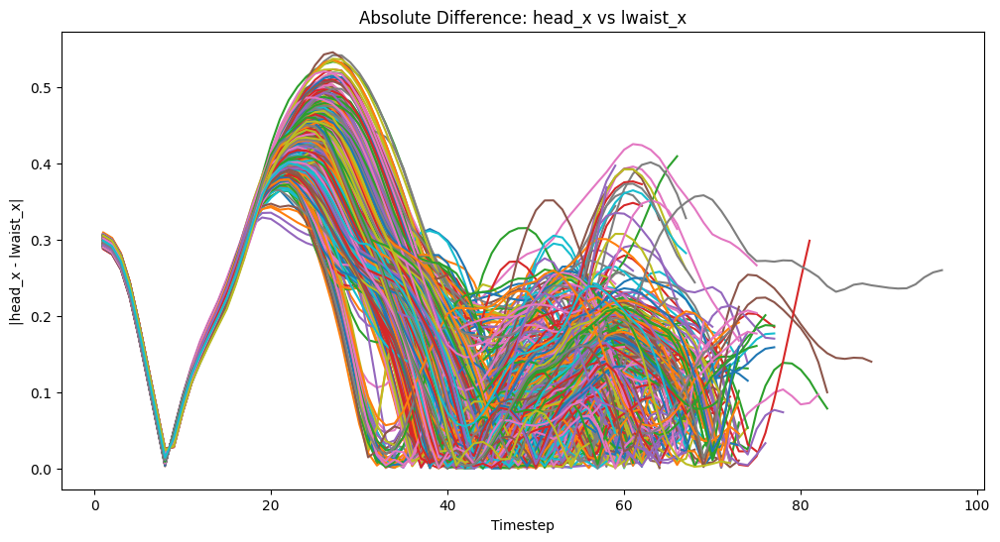

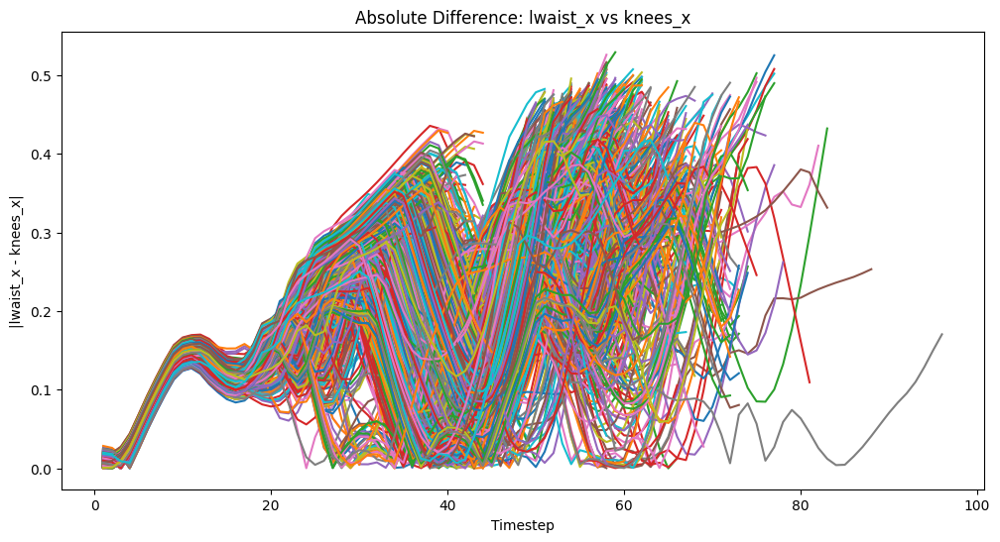

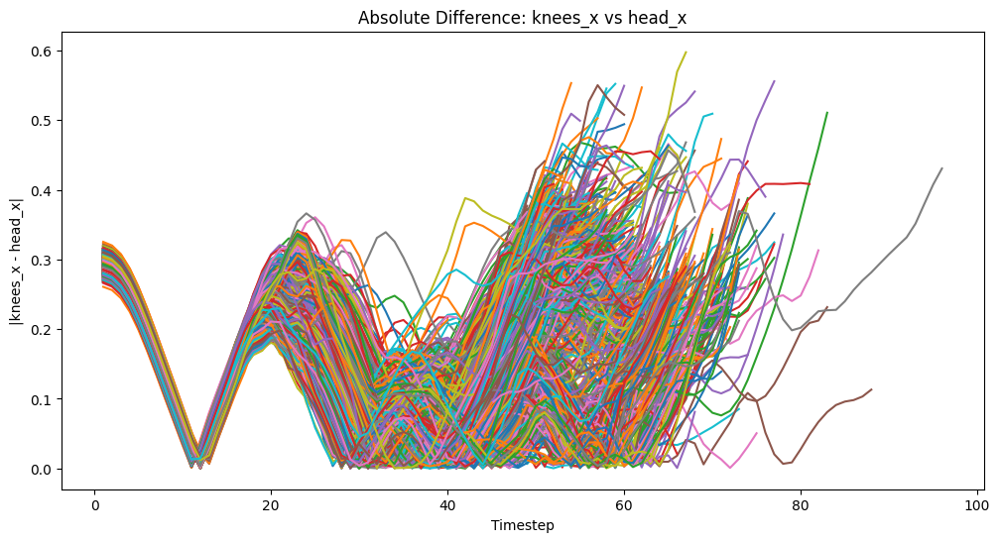

In [21]:
import gymnasium as gym
import numpy as np
from stable_baselines3 import PPO
import matplotlib.pyplot as plt
import mujoco  # make sure you have the proper mujoco bindings installed

def get_body_x(env, body_name):
    """
    Extract the x-coordinate (index 0 of the position vector)
    of a given body in the MuJoCo environment.
    
    For knee bodies ("left_knee" or "right_knee"), it uses the compute_knee_pos
    function with a predefined local offset based on the model's geometry.
    """
    if body_name == "left_knee":
        # According to the XML, the left thigh's capsule fromto is "0 0 0 0 -0.01 -0.34".
        # Use that to define the local offset relative to the left_thigh.
        local_offset = np.array([0, -0.01, -0.34])
        knee_pos = compute_knee_pos(env, "left_thigh", local_offset)
        return knee_pos[0]
    elif body_name == "right_knee":
        # According to the XML, the right thigh's capsule fromto is "0 0 0 0 0.01 -0.34".
        local_offset = np.array([0, 0.01, -0.34])
        knee_pos = compute_knee_pos(env, "right_thigh", local_offset)
        return knee_pos[0]
    else:
        # For other bodies, simply retrieve the global position from xipos.
        body_id = mujoco.mj_name2id(env.unwrapped.model, mujoco.mjtObj.mjOBJ_BODY.value, body_name)
        pos = env.unwrapped.data.xipos[body_id]
        return pos[0]

# Create the environment; using render_mode "human" if you want to see it running.
env = gym.make("Humanoid-v5", render_mode="human")
# Load your trained model.
model = PPO.load("spicy_walker", env=env)       
num_episodes = 1000

# These lists will store the per-episode time series for each difference.
all_timesteps = []
all_diff_head_lwaist = []  # |head_x - lwaist_x|
all_diff_lwaist_knees = []  # |lwaist_x - knees_x|
all_diff_knees_head = []    # |knees_x - head_x|

for ep in range(num_episodes):
    obs, _ = env.reset()
    done = False
    truncated = False
    timestep = 0

    # Per-episode lists to record timesteps and differences.
    ep_timesteps = []
    ep_diff_head_lwaist = []
    ep_diff_lwaist_knees = []
    ep_diff_knees_head = []

    while not (done or truncated):
        # Use the trained model's prediction instead of sampling random actions.
        action, _states = model.predict(obs, deterministic=True)
        obs, reward, done, truncated, info = env.step(action)
        timestep += 1
        ep_timesteps.append(timestep)
        
        try:
            # Extract x-coordinates for key bodies.
            head_x   = get_body_x(env, "head")
            lwaist_x = get_body_x(env, "lwaist")
            left_knee_x  = get_body_x(env, "left_knee")
            right_knee_x = get_body_x(env, "right_knee")
            knees_x = (left_knee_x + right_knee_x) / 2.0
        except Exception as e:
            print(f"Error extracting body info: {e}")
            head_x = lwaist_x = knees_x = 0

        # Calculate the absolute differences.
        diff1 = np.abs(head_x - lwaist_x)
        diff2 = np.abs(lwaist_x - knees_x)
        diff3 = np.abs(knees_x - head_x)
        
        ep_diff_head_lwaist.append(diff1)
        ep_diff_lwaist_knees.append(diff2)
        ep_diff_knees_head.append(diff3)
        
        env.render()

    # Store episode data.
    all_timesteps.append(ep_timesteps)
    all_diff_head_lwaist.append(ep_diff_head_lwaist)
    all_diff_lwaist_knees.append(ep_diff_lwaist_knees)
    all_diff_knees_head.append(ep_diff_knees_head)
    print(f"Episode {ep + 1} finished in {timestep} timesteps.")

env.close()

# Now plot the differences from all episodes (no legends, per request)
plt.figure(figsize=(12, 6))
for i in range(num_episodes):
    plt.plot(all_timesteps[i], all_diff_head_lwaist[i])
plt.xlabel("Timestep")
plt.ylabel("|head_x - lwaist_x|")
plt.title("Absolute Difference: head_x vs lwaist_x")

plt.figure(figsize=(12, 6))
for i in range(num_episodes):
    plt.plot(all_timesteps[i], all_diff_lwaist_knees[i])
plt.xlabel("Timestep")
plt.ylabel("|lwaist_x - knees_x|")
plt.title("Absolute Difference: lwaist_x vs knees_x")

plt.figure(figsize=(12, 6))
for i in range(num_episodes):
    plt.plot(all_timesteps[i], all_diff_knees_head[i])
plt.xlabel("Timestep")
plt.ylabel("|knees_x - head_x|")
plt.title("Absolute Difference: knees_x vs head_x")

plt.show()

# leaning Hack

## Shin Baseline

Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
Episode 1 finished in 52 timesteps.
Episode 2 finished in 61 timesteps.
Episode 3 finished in 57 timesteps.
Episode 4 finished in 56 timesteps.
Episode 5 finished in 60 timesteps.
Episode 6 finished in 53 timesteps.
Episode 7 finished in 66 timesteps.
Episode 8 finished in 57 timesteps.
Episode 9 finished in 62 timesteps.
Episode 10 finished in 57 timesteps.
Episode 11 finished in 70 timesteps.
Episode 12 finished in 53 timesteps.
Episode 13 finished in 63 timesteps.
Episode 14 finished in 54 timesteps.
Episode 15 finished in 56 timesteps.
Episode 16 finished in 44 timesteps.
Episode 17 finished in 62 timesteps.
Episode 18 finished in 53 timesteps.
Episode 19 finished in 59 timesteps.
Episode 20 finished in 60 timesteps.
Episode 21 finished in 57 timesteps.
Episode 22 finished in 66 timesteps.
Episode 23 finished in 68 timesteps.
Episode 24 finished in 42 timesteps.
Episode 25 finished in 60 timesteps.
Episode

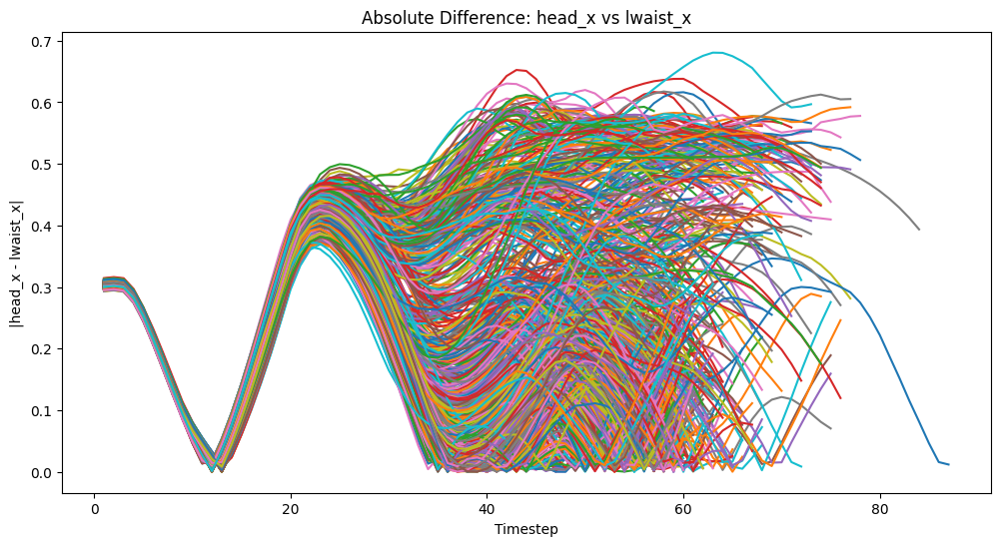

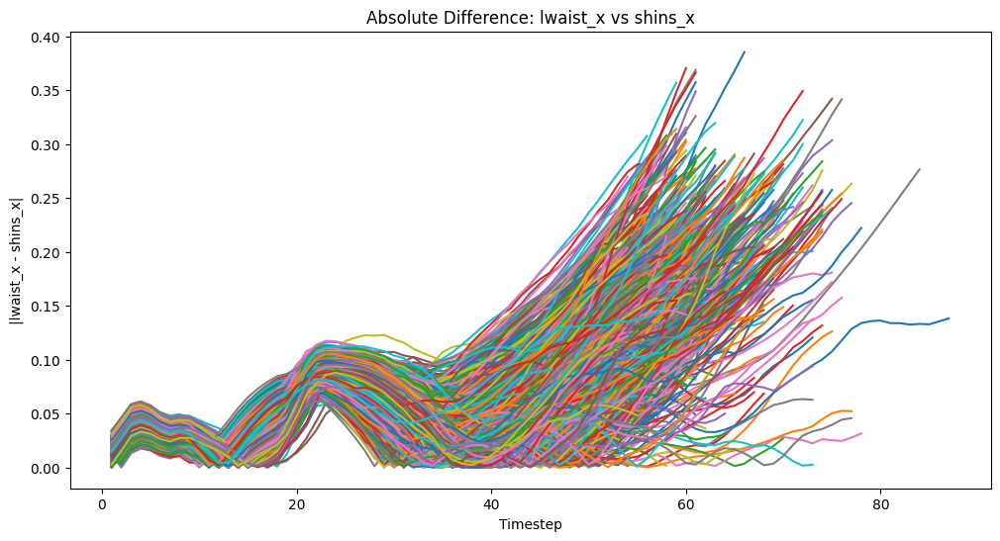

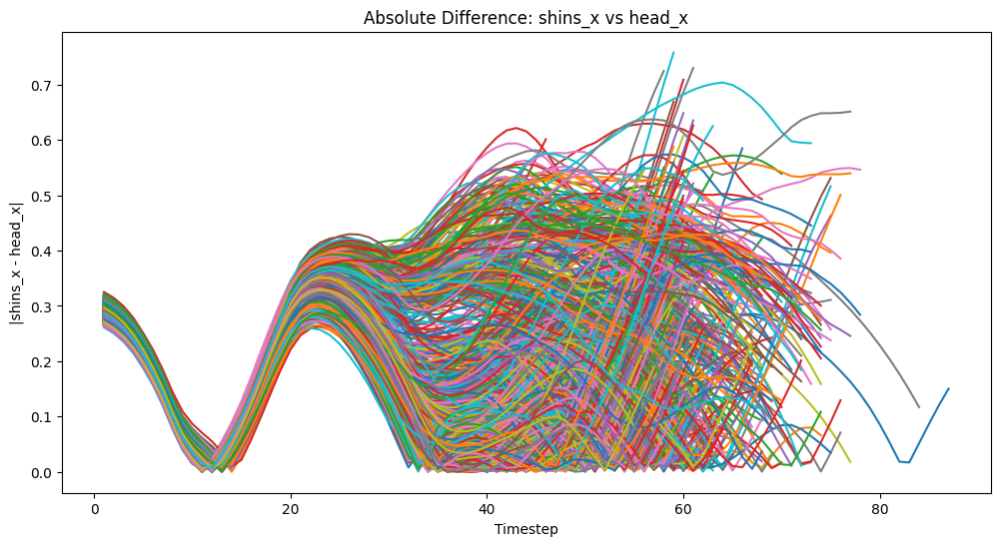

In [23]:
import gymnasium as gym
import numpy as np
from stable_baselines3 import PPO
import matplotlib.pyplot as plt
import mujoco  # make sure you have the proper mujoco bindings installed

def get_body_x(env, body_name):
    """
    Extract the x-coordinate (index 0 of the position vector)
    of a given body in the MuJoCo environment.
    """
    body_id = mujoco.mj_name2id(env.unwrapped.model, mujoco.mjtObj.mjOBJ_BODY.value, body_name)
    pos = env.unwrapped.data.xipos[body_id]
    return pos[0]

# Create the environment; using render_mode "human" if you want to see it running.
env = gym.make("Humanoid-v5", render_mode="human")

# Load your trained model.
model = PPO.load("spicy_walker_Xacc_std2", env=env)       
num_episodes = 1000

# These lists will store the per-episode time series for each difference.
all_timesteps = []
all_diff_head_lwaist = []  # |head_x - lwaist_x|
all_diff_lwaist_shins = [] # |lwaist_x - shins_x|
all_diff_shins_head = []   # |shins_x - head_x|

for ep in range(num_episodes):
    obs, _ = env.reset()
    done = False
    truncated = False
    timestep = 0

    # Per-episode lists to record timesteps and differences.
    ep_timesteps = []
    ep_diff_head_lwaist = []
    ep_diff_lwaist_shins = []
    ep_diff_shins_head = []

    while not (done or truncated):
        # Use the trained model's prediction instead of sampling random actions.
        action, _states = model.predict(obs, deterministic=True)
        obs, reward, done, truncated, info = env.step(action)
        timestep += 1
        ep_timesteps.append(timestep)
        
        # Extract the x-coordinate for each body.
        try:
            head_x = get_body_x(env, "head")
            lwaist_x = get_body_x(env, "lwaist")
            # Access left_shin and right_shin separately and compute their mean.
            lshin_x = get_body_x(env, "left_shin")
            rshin_x = get_body_x(env, "right_shin")
            shins_x = (lshin_x + rshin_x) / 2.0
        except Exception as e:
            print(f"Error extracting body info: {e}")
            head_x = lwaist_x = shins_x = 0

        # Calculate the absolute differences.
        diff1 = np.abs(head_x - lwaist_x)
        diff2 = np.abs(lwaist_x - shins_x)
        diff3 = np.abs(shins_x - head_x)
        
        ep_diff_head_lwaist.append(diff1)
        ep_diff_lwaist_shins.append(diff2)
        ep_diff_shins_head.append(diff3)
        
        env.render()

    # Store episode data.
    all_timesteps.append(ep_timesteps)
    all_diff_head_lwaist.append(ep_diff_head_lwaist)
    all_diff_lwaist_shins.append(ep_diff_lwaist_shins)
    all_diff_shins_head.append(ep_diff_shins_head)
    print(f"Episode {ep + 1} finished in {timestep} timesteps.")

env.close()

# Now plot the differences from all episodes (no legends, per request)
plt.figure(figsize=(12, 6))
for i in range(num_episodes):
    plt.plot(all_timesteps[i], all_diff_head_lwaist[i])
plt.xlabel("Timestep")
plt.ylabel("|head_x - lwaist_x|")
plt.title("Absolute Difference: head_x vs lwaist_x")

plt.figure(figsize=(12, 6))
for i in range(num_episodes):
    plt.plot(all_timesteps[i], all_diff_lwaist_shins[i])
plt.xlabel("Timestep")
plt.ylabel("|lwaist_x - shins_x|")
plt.title("Absolute Difference: lwaist_x vs shins_x")

plt.figure(figsize=(12, 6))
for i in range(num_episodes):
    plt.plot(all_timesteps[i], all_diff_shins_head[i])
plt.xlabel("Timestep")
plt.ylabel("|shins_x - head_x|")
plt.title("Absolute Difference: shins_x vs head_x")

plt.show()

Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
Episode 1 finished in 66 timesteps.
Episode 2 finished in 57 timesteps.
Episode 3 finished in 62 timesteps.
Episode 4 finished in 55 timesteps.
Episode 5 finished in 56 timesteps.
Episode 6 finished in 60 timesteps.
Episode 7 finished in 62 timesteps.
Episode 8 finished in 60 timesteps.
Episode 9 finished in 58 timesteps.
Episode 10 finished in 59 timesteps.
Episode 11 finished in 42 timesteps.
Episode 12 finished in 61 timesteps.
Episode 13 finished in 68 timesteps.
Episode 14 finished in 59 timesteps.
Episode 15 finished in 53 timesteps.
Episode 16 finished in 59 timesteps.
Episode 17 finished in 63 timesteps.
Episode 18 finished in 58 timesteps.
Episode 19 finished in 49 timesteps.
Episode 20 finished in 72 timesteps.
Episode 21 finished in 44 timesteps.
Episode 22 finished in 62 timesteps.
Episode 23 finished in 63 timesteps.
Episode 24 finished in 54 timesteps.
Episode 25 finished in 61 timesteps.
Episode

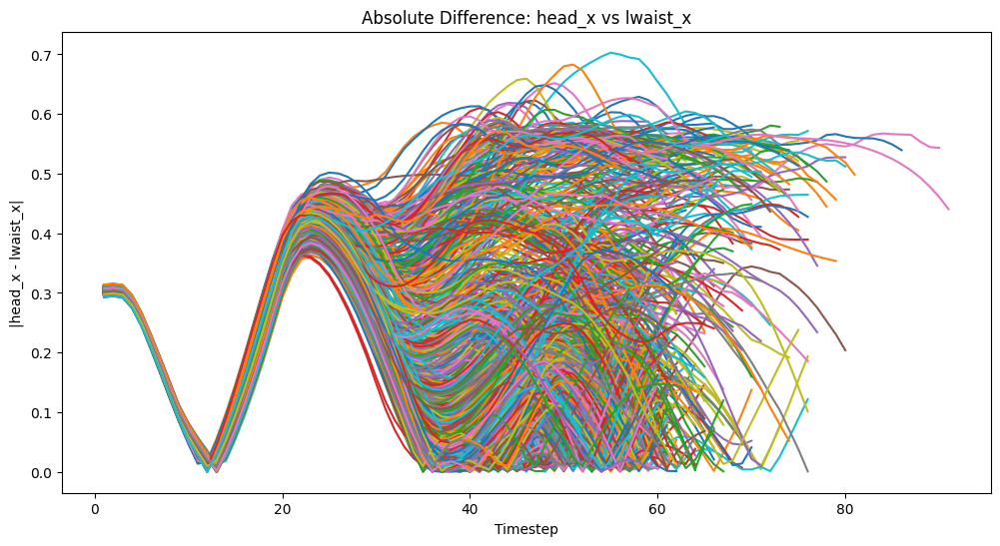

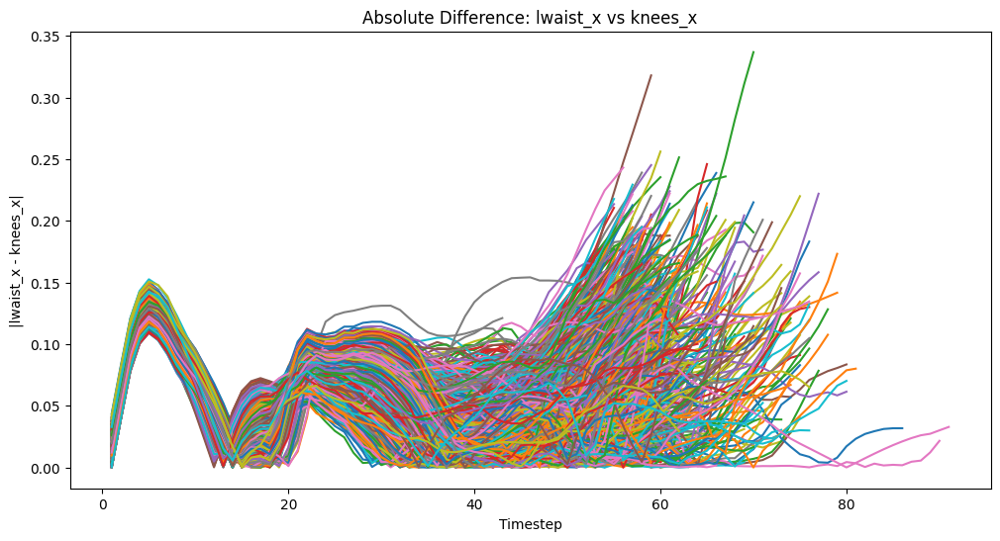

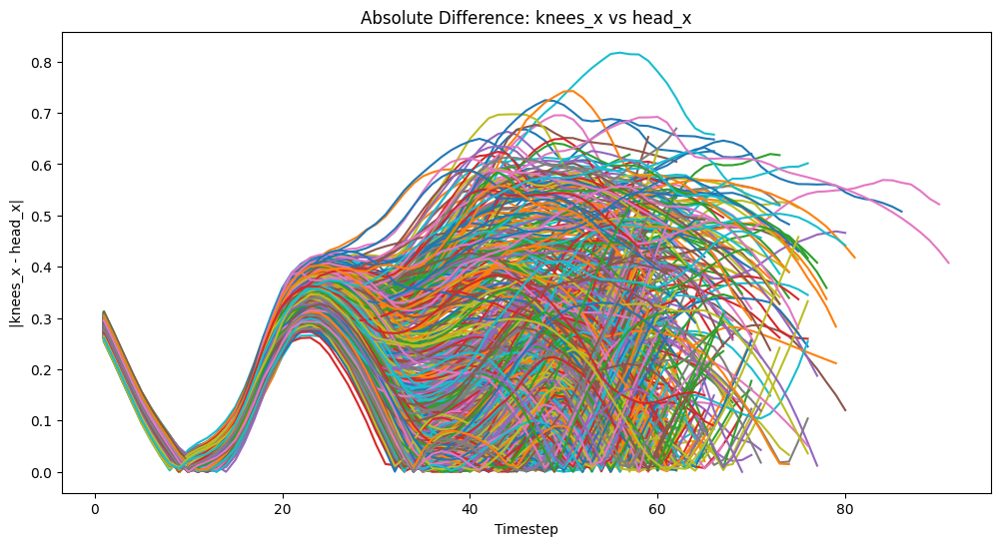

In [24]:
import gymnasium as gym
import numpy as np
from stable_baselines3 import PPO
import matplotlib.pyplot as plt
import mujoco  # make sure you have the proper mujoco bindings installed

def get_body_x(env, body_name):
    """
    Extract the x-coordinate (index 0 of the position vector)
    of a given body in the MuJoCo environment.
    
    For knee bodies ("left_knee" or "right_knee"), it uses the compute_knee_pos
    function with a predefined local offset based on the model's geometry.
    """
    if body_name == "left_knee":
        # According to the XML, the left thigh's capsule fromto is "0 0 0 0 -0.01 -0.34".
        # Use that to define the local offset relative to the left_thigh.
        local_offset = np.array([0, -0.01, -0.34])
        knee_pos = compute_knee_pos(env, "left_thigh", local_offset)
        return knee_pos[0]
    elif body_name == "right_knee":
        # According to the XML, the right thigh's capsule fromto is "0 0 0 0 0.01 -0.34".
        local_offset = np.array([0, 0.01, -0.34])
        knee_pos = compute_knee_pos(env, "right_thigh", local_offset)
        return knee_pos[0]
    else:
        # For other bodies, simply retrieve the global position from xipos.
        body_id = mujoco.mj_name2id(env.unwrapped.model, mujoco.mjtObj.mjOBJ_BODY.value, body_name)
        pos = env.unwrapped.data.xipos[body_id]
        return pos[0]

# Create the environment; using render_mode "human" if you want to see it running.
env = gym.make("Humanoid-v5", render_mode="human")
# Load your trained model.
model = PPO.load("spicy_walker_Xacc_std2", env=env)       
num_episodes = 1000

# These lists will store the per-episode time series for each difference.
all_timesteps = []
all_diff_head_lwaist = []  # |head_x - lwaist_x|
all_diff_lwaist_knees = []  # |lwaist_x - knees_x|
all_diff_knees_head = []    # |knees_x - head_x|

for ep in range(num_episodes):
    obs, _ = env.reset()
    done = False
    truncated = False
    timestep = 0

    # Per-episode lists to record timesteps and differences.
    ep_timesteps = []
    ep_diff_head_lwaist = []
    ep_diff_lwaist_knees = []
    ep_diff_knees_head = []

    while not (done or truncated):
        # Use the trained model's prediction instead of sampling random actions.
        action, _states = model.predict(obs, deterministic=True)
        obs, reward, done, truncated, info = env.step(action)
        timestep += 1
        ep_timesteps.append(timestep)
        
        try:
            # Extract x-coordinates for key bodies.
            head_x   = get_body_x(env, "head")
            lwaist_x = get_body_x(env, "lwaist")
            left_knee_x  = get_body_x(env, "left_knee")
            right_knee_x = get_body_x(env, "right_knee")
            knees_x = (left_knee_x + right_knee_x) / 2.0
        except Exception as e:
            print(f"Error extracting body info: {e}")
            head_x = lwaist_x = knees_x = 0

        # Calculate the absolute differences.
        diff1 = np.abs(head_x - lwaist_x)
        diff2 = np.abs(lwaist_x - knees_x)
        diff3 = np.abs(knees_x - head_x)
        
        ep_diff_head_lwaist.append(diff1)
        ep_diff_lwaist_knees.append(diff2)
        ep_diff_knees_head.append(diff3)
        
        env.render()

    # Store episode data.
    all_timesteps.append(ep_timesteps)
    all_diff_head_lwaist.append(ep_diff_head_lwaist)
    all_diff_lwaist_knees.append(ep_diff_lwaist_knees)
    all_diff_knees_head.append(ep_diff_knees_head)
    print(f"Episode {ep + 1} finished in {timestep} timesteps.")

env.close()

# Now plot the differences from all episodes (no legends, per request)
plt.figure(figsize=(12, 6))
for i in range(num_episodes):
    plt.plot(all_timesteps[i], all_diff_head_lwaist[i])
plt.xlabel("Timestep")
plt.ylabel("|head_x - lwaist_x|")
plt.title("Absolute Difference: head_x vs lwaist_x")

plt.figure(figsize=(12, 6))
for i in range(num_episodes):
    plt.plot(all_timesteps[i], all_diff_lwaist_knees[i])
plt.xlabel("Timestep")
plt.ylabel("|lwaist_x - knees_x|")
plt.title("Absolute Difference: lwaist_x vs knees_x")

plt.figure(figsize=(12, 6))
for i in range(num_episodes):
    plt.plot(all_timesteps[i], all_diff_knees_head[i])
plt.xlabel("Timestep")
plt.ylabel("|knees_x - head_x|")
plt.title("Absolute Difference: knees_x vs head_x")

plt.show()

In [80]:
def sigmoid(x, loc, slope):
    return 1 / (1 + np.exp(-slope * (x - loc)))

In [ ]:
x=np.linspace(1, 50)
100 * exponnorm.pdf(x, K=2, loc=15, scale=4)

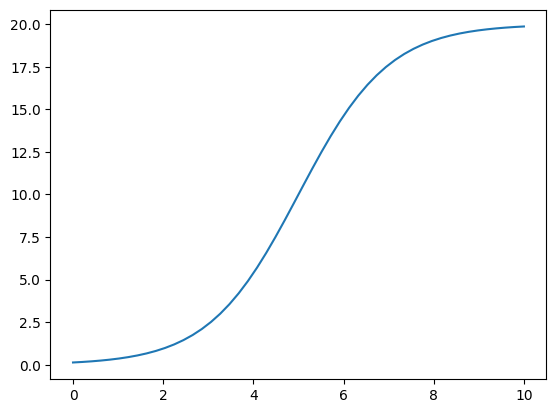

In [ ]:
x=np.linspace(0, 10)
plt.plot(x, sigmoid(x, loc=5, slope=1)*20)